<a href="https://colab.research.google.com/github/EmaanBashir/Congestion-Analysis-And-Route-Optimization/blob/main/Code/Congestion_Analysis_and_Route_Optimization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
# Imports
import xml.etree.ElementTree as ET
import pandas as pd
import os
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from matplotlib import colors as mcolors
import random
import folium
import pytz
import networkx as nx

## Analysis based on timetable data

In [ ]:
# Load the preprocessed timetable data
timetable_processed_df = pd.read_hdf('/content/drive/MyDrive/MSc Project Data/timetable_processed.h5', key = 'df')

# Extract the time part from UpdatedDepartureTime and Arrival time
timetable_processed_df['DepartureTime'] = pd.to_datetime(timetable_processed_df['DepartureTime'], format='%H:%M:%S').dt.time
timetable_processed_df['ArrivalTime'] = pd.to_datetime(timetable_processed_df['ArrivalTime'], format='%H:%M:%S').dt.time

# Filter out a single journey
timetable_processed_df[(timetable_processed_df['LineRef'] == 'NCTR:PB0002362:29:6') & (timetable_processed_df['DepartureDay'] == 'Monday') & (timetable_processed_df['JourneyCode'] == '1009')].head()

,BlockNumber,JourneyCode,LineRef,DepartureDay,DepartureTime,FromStopPointRef,From(SequenceNumber),ToStopPointRef,To(SequenceNumber),RunTime,ArrivalTime,RouteLinkId,"Track(Longitude, Latitude)",TrackDistance,Speed,LineName
641751,1006,1009,NCTR:PB0002362:29:6,Monday,06:08:00,3300RU0135,1,3300RU0186,2,60.0,06:09:00,6:1_1_2147481621,"((-1.1119231, 52.9125312), (-1.111863, 52.9125...",376.430035,6.273834,6
641752,1006,1009,NCTR:PB0002362:29:6,Monday,06:09:00,3300RU0186,2,3300RU0214,3,60.0,06:10:00,6:1_2_2147481620,"((-1.1082311, 52.9144537), (-1.108405, 52.9147...",350.296587,5.838276,6
641753,1006,1009,NCTR:PB0002362:29:6,Monday,06:10:00,3300RU0214,3,3300RU0222,4,60.0,06:11:00,6:1_3_2147481619,"((-1.1100495, 52.9172611), (-1.110106, 52.9173...",358.224427,5.970407,6
641754,1006,1009,NCTR:PB0002362:29:6,Monday,06:11:00,3300RU0222,4,3300RU0220,5,0.0,06:11:00,6:1_4_2147481618,"((-1.1122372, 52.9201959), (-1.112551, 52.9206...",144.792588,4.445692,6
641755,1006,1009,NCTR:PB0002362:29:6,Monday,06:11:00,3300RU0220,5,3300RU0286,6,60.0,06:12:00,6:1_5_2147481617,"((-1.1131147, 52.921384), (-1.114325, 52.92302...",333.543226,5.559054,6


In [ ]:
# Calculate the average speed and bus density based on day and time

# Define the constraints
day = 'Monday'
start_time = pd.to_datetime('13:00:00').time()
end_time = pd.to_datetime('14:30:00').time()

# Extract data after applying the constraints
avg_speed_df = timetable_processed_df[
    (timetable_processed_df['DepartureDay'] == day) &
    (timetable_processed_df['DepartureTime'] >= start_time) &
    (timetable_processed_df['DepartureTime'] <= end_time) &
    (timetable_processed_df['ArrivalTime'] >= start_time) &
    (timetable_processed_df['ArrivalTime'] <= end_time)
].copy()

# Create BusCount column by counting the number of rows in each RouteLinkId group
avg_speed_df['BusCount'] = avg_speed_df.groupby('RouteLinkId')['RouteLinkId'].transform('count')

# Get the average speed, distance and bus count for each route link
avg_speed_df = avg_speed_df.groupby('RouteLinkId').agg({
    'TrackDistance': 'mean',
    'Speed': 'mean',
    'BusCount': 'mean'
}).reset_index()

# Calculate bus density using the formula (bus count / track distance)
avg_speed_df['BusDensity'] = avg_speed_df.apply(lambda row: row['BusCount'] / row['TrackDistance'], axis=1)

# Rename the coulumn speed as average speed
avg_speed_df.rename(columns={'Speed': 'AverageSpeed'}, inplace=True)

avg_speed_df.head()

,RouteLinkId,TrackDistance,AverageSpeed,BusCount,BusDensity
0,10:1_10_2147481803,345.284223,5.754737,6.0,0.017377
1,10:1_11_2147481802,186.169580,4.738900,7.0,0.037600
2,10:1_12_2147481801,324.205438,5.403424,6.0,0.018507
3,10:1_13_2147481800,397.139085,6.618985,6.0,0.015108
4,10:1_14_2147481799,260.830928,4.347182,6.0,0.023003


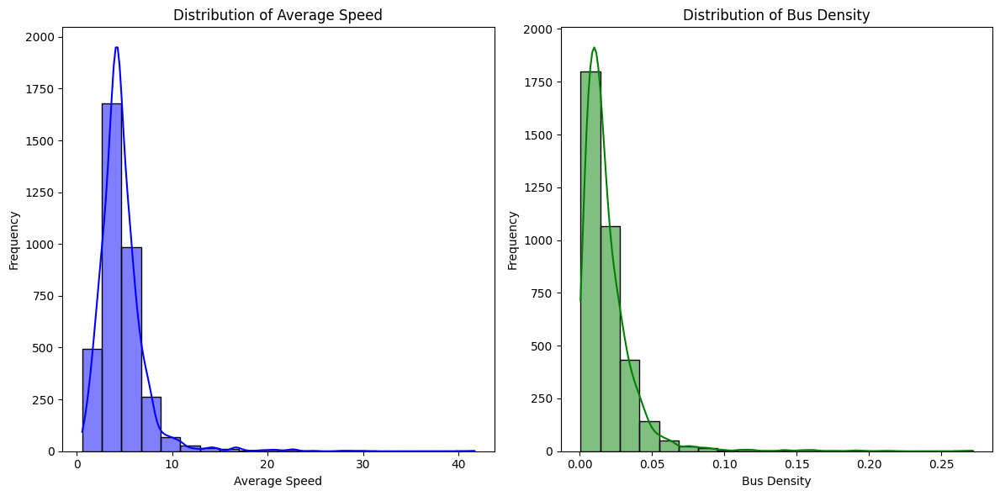

In [ ]:
# Plot the distribution of AverageSpeed and Bus Density

plt.figure(figsize=(12, 6))

# Histogram and KDE for AverageSpeed
plt.subplot(1, 2, 1)
sns.histplot(avg_speed_df['AverageSpeed'], bins=20, kde=True, color='blue')
plt.title('Distribution of Average Speed')
plt.xlabel('Average Speed')
plt.ylabel('Frequency')

# Histogram and KDE for BusDensity
plt.subplot(1, 2, 2)
sns.histplot(avg_speed_df['BusDensity'], bins=20, kde=True, color='green')
plt.title('Distribution of Bus Density')
plt.xlabel('Bus Density')
plt.ylabel('Frequency')

# Adjust layout
plt.tight_layout()
plt.show()


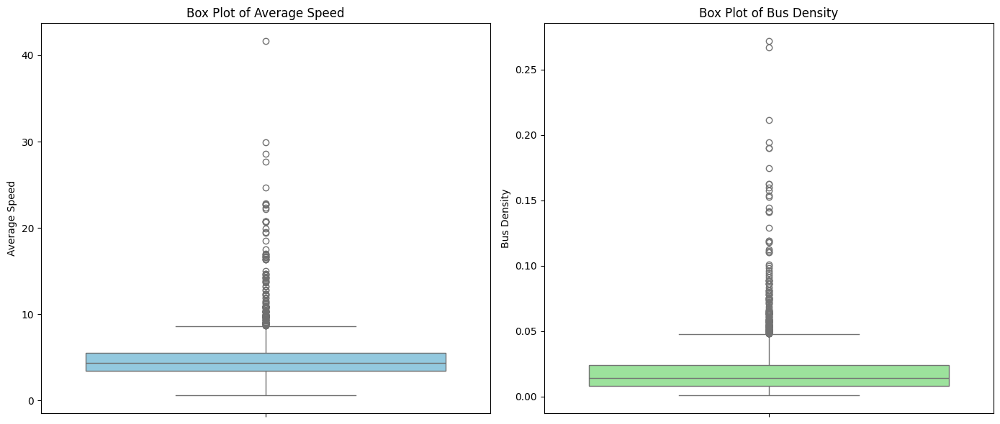

In [ ]:
# Boxplots for average speed and bus density

# Set up the plotting area
plt.figure(figsize=(14, 6))

# Box plot for AverageSpeed
plt.subplot(1, 2, 1)
sns.boxplot(y=avg_speed_df['AverageSpeed'], color='skyblue')
plt.title('Box Plot of Average Speed')
plt.ylabel('Average Speed')

# Box plot for BusDensity
plt.subplot(1, 2, 2)
sns.boxplot(y=avg_speed_df['BusDensity'], color='lightgreen')
plt.title('Box Plot of Bus Density')
plt.ylabel('Bus Density')

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
# # Calculate z-scores
# z_scores = np.abs(stats.zscore(avg_speed_df[['AverageSpeed', 'BusDensity']]))

# # Set a threshold for identifying outliers
# threshold = 3

# # Identify outliers
# outliers = (z_scores > threshold).any(axis=1)

# # Remove outliers
# avg_speed_df = avg_speed_df[~outliers]

In [ ]:
# # Plot the distribution of AverageSpeed and BusDensity

# plt.figure(figsize=(12, 6))

# # Histogram and KDE for AverageSpeed
# plt.subplot(1, 2, 1)
# sns.histplot(avg_speed_df['AverageSpeed'], bins=20, kde=True, color='blue')
# plt.title('Distribution of Average Speed')
# plt.xlabel('Average Speed')
# plt.ylabel('Frequency')

# # Histogram and KDE for BusDensity
# plt.subplot(1, 2, 2)
# sns.histplot(avg_speed_df['BusDensity'], bins=20, kde=True, color='green')
# plt.title('Distribution of Bus Density')
# plt.xlabel('Bus Density')
# plt.ylabel('Frequency')

# # Adjust layout
# plt.tight_layout()
# plt.show()


In [ ]:
# # Plot Box plots for average speed and bus density

# # Set up the plotting area
# plt.figure(figsize=(14, 6))

# # Box plot for AverageSpeed
# plt.subplot(1, 2, 1)
# sns.boxplot(y=avg_speed_df['AverageSpeed'], color='skyblue')
# plt.title('Box Plot of Average Speed')
# plt.ylabel('Average Speed')

# # Box plot for BusDensity
# plt.subplot(1, 2, 2)
# sns.boxplot(y=avg_speed_df['BusDensity'], color='lightgreen')
# plt.title('Box Plot of Bus Density')
# plt.ylabel('Bus Density')

# # Adjust layout
# plt.tight_layout()
# plt.show()


In [ ]:
# KNN Classification

# Features to use for k-NN
features = avg_speed_df[['AverageSpeed', 'BusDensity']]

# Normalize the features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Cluster Centers:
[[ 0.11404238 -0.31917181]
 [-0.53885944  1.50811247]]

DataFrame with Clusters:
          RouteLinkId  TrackDistance  AverageSpeed  BusCount  BusDensity  \
0  10:1_10_2147481803     345.284223      5.754737       6.0    0.017377   
1  10:1_11_2147481802     186.169580      4.738900       7.0    0.037600   
2  10:1_12_2147481801     324.205438      5.403424       6.0    0.018507   
3  10:1_13_2147481800     397.139085      6.618985       6.0    0.015108   
4  10:1_14_2147481799     260.830928      4.347182       6.0    0.023003   

   KNN Cluster(k = 2)  
0                   0  
1                   1  
2                   0  
3                   0  
4                   0  


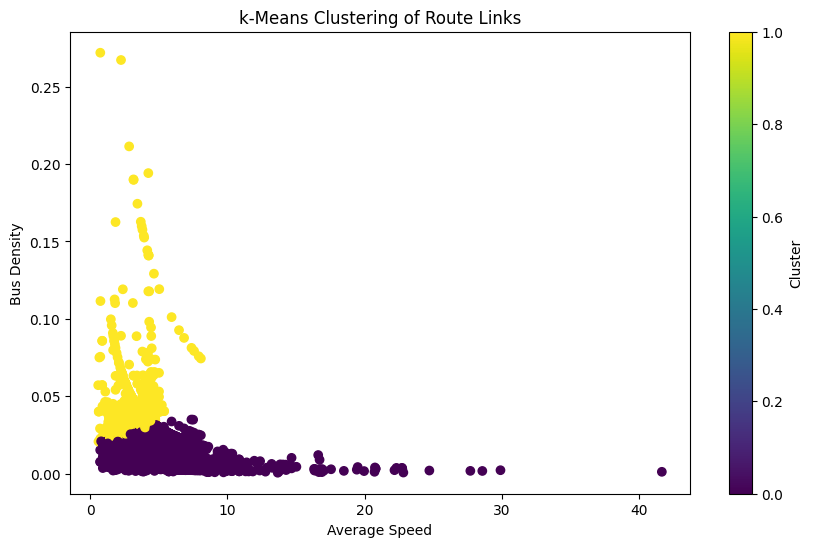

In [ ]:
# Initialize k-Means with a chosen number of clusters

k = 2  # Number of clusters
kmeans = KMeans(n_clusters=k, random_state=42)
avg_speed_df['KNN Cluster(k = ' + str(k) + ')'] = kmeans.fit_predict(features_scaled)

# Print cluster centers
print("Cluster Centers:")
print(kmeans.cluster_centers_)

# Print the DataFrame with cluster labels
print("\nDataFrame with Clusters:")
print(avg_speed_df.head())

# Plot the clusters
plt.figure(figsize=(10, 6))
plt.scatter(avg_speed_df['AverageSpeed'], avg_speed_df['BusDensity'], c=avg_speed_df['KNN Cluster(k = ' + str(k) + ')'], cmap='viridis', marker='o')
plt.xlabel('Average Speed')
plt.ylabel('Bus Density')
plt.title('k-Means Clustering of Route Links')
plt.colorbar(label='Cluster')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Cluster Centers:
[[-0.51925817  1.76407692]
 [-0.07801158 -0.25672062]
 [ 3.25691289 -0.75663871]]

DataFrame with Clusters:
          RouteLinkId  TrackDistance  AverageSpeed  BusCount  BusDensity  \
0  10:1_10_2147481803     345.284223      5.754737       6.0    0.017377   
1  10:1_11_2147481802     186.169580      4.738900       7.0    0.037600   
2  10:1_12_2147481801     324.205438      5.403424       6.0    0.018507   
3  10:1_13_2147481800     397.139085      6.618985       6.0    0.015108   
4  10:1_14_2147481799     260.830928      4.347182       6.0    0.023003   

   KNN Cluster(k = 2)  KNN Cluster(k = 3)  
0                   0                   1  
1                   1                   0  
2                   0                   1  
3                   0                   1  
4                   0                   1  


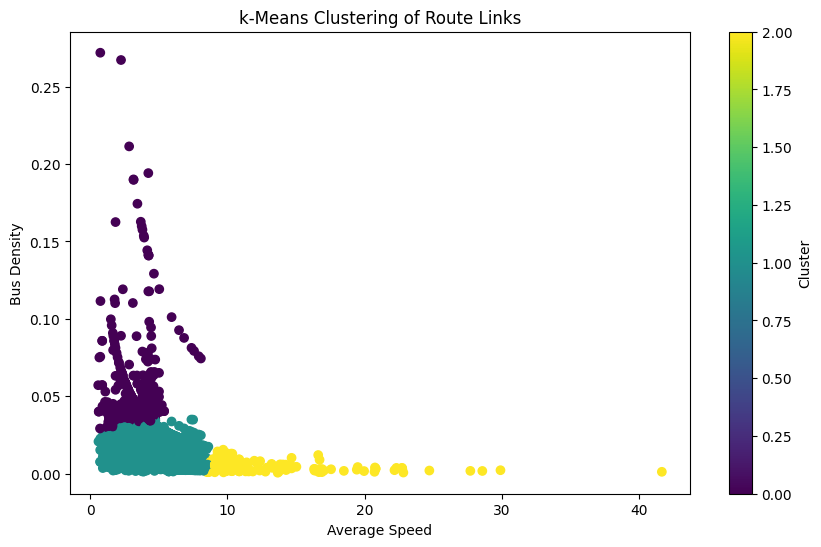

In [ ]:
# Initialize k-Means with a chosen number of clusters

k = 3  # Number of clusters
kmeans = KMeans(n_clusters=k, random_state=42)
avg_speed_df['KNN Cluster(k = ' + str(k) + ')'] = kmeans.fit_predict(features_scaled)

# Print cluster centers
print("Cluster Centers:")
print(kmeans.cluster_centers_)

# Print the DataFrame with cluster labels
print("\nDataFrame with Clusters:")
print(avg_speed_df.head())

# Plot the clusters
plt.figure(figsize=(10, 6))
plt.scatter(avg_speed_df['AverageSpeed'], avg_speed_df['BusDensity'], c=avg_speed_df['KNN Cluster(k = ' + str(k) + ')'], cmap='viridis', marker='o')
plt.xlabel('Average Speed')
plt.ylabel('Bus Density')
plt.title('k-Means Clustering of Route Links')
plt.colorbar(label='Cluster')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Cluster Centers:
[[-0.46331674  0.08204427]
 [-0.56000157  3.52534511]
 [ 0.63794229 -0.48947831]
 [ 5.30492718 -0.82277903]]

DataFrame with Clusters:
          RouteLinkId  TrackDistance  AverageSpeed  BusCount  BusDensity  \
0  10:1_10_2147481803     345.284223      5.754737       6.0    0.017377   
1  10:1_11_2147481802     186.169580      4.738900       7.0    0.037600   
2  10:1_12_2147481801     324.205438      5.403424       6.0    0.018507   
3  10:1_13_2147481800     397.139085      6.618985       6.0    0.015108   
4  10:1_14_2147481799     260.830928      4.347182       6.0    0.023003   

   KNN Cluster(k = 2)  KNN Cluster(k = 3)  KNN Cluster(k = 4)  
0                   0                   1                   2  
1                   1                   0                   0  
2                   0                   1                   2  
3                   0                   1                   2  
4                   0                   1                   0  


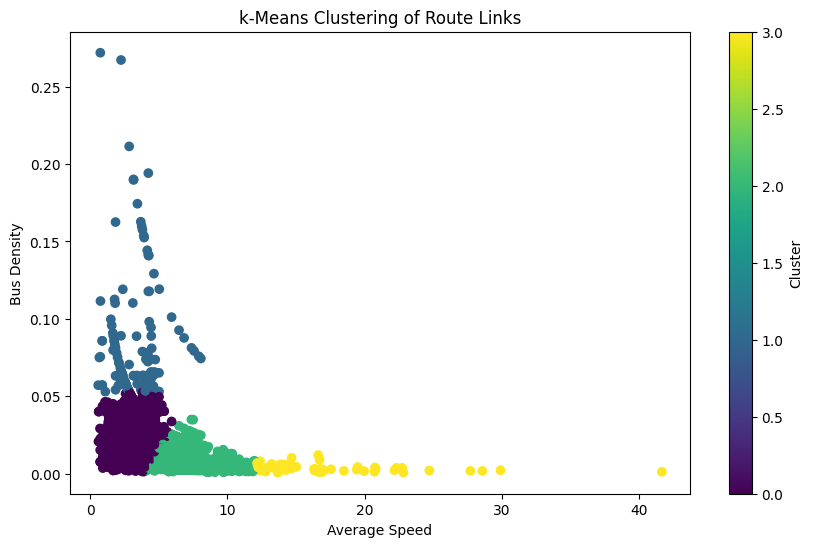

In [ ]:
# Initialize k-Means with a chosen number of clusters
k = 4  # Number of clusters
kmeans = KMeans(n_clusters=k, random_state=42)
avg_speed_df['KNN Cluster(k = ' + str(k) + ')'] = kmeans.fit_predict(features_scaled)

# Print cluster centers
print("Cluster Centers:")
print(kmeans.cluster_centers_)

# Print the DataFrame with cluster labels
print("\nDataFrame with Clusters:")
print(avg_speed_df.head())

# Optional: Plot the clusters
plt.figure(figsize=(10, 6))
plt.scatter(avg_speed_df['AverageSpeed'], avg_speed_df['BusDensity'], c=avg_speed_df['KNN Cluster(k = ' + str(k) + ')'], cmap='viridis', marker='o')
plt.xlabel('Average Speed')
plt.ylabel('Bus Density')
plt.title('k-Means Clustering of Route Links')
plt.colorbar(label='Cluster')
plt.show()

In [ ]:
avg_speed_df.head()

,RouteLinkId,TrackDistance,AverageSpeed,BusCount,BusDensity,KNN Cluster(k = 2),KNN Cluster(k = 3),KNN Cluster(k = 4)
0,10:1_10_2147481803,345.284223,5.754737,6.0,0.017377,0,1,2
1,10:1_11_2147481802,186.169580,4.738900,7.0,0.037600,1,0,0
2,10:1_12_2147481801,324.205438,5.403424,6.0,0.018507,0,1,2
3,10:1_13_2147481800,397.139085,6.618985,6.0,0.015108,0,1,2
4,10:1_14_2147481799,260.830928,4.347182,6.0,0.023003,0,1,0


DataFrame with Clusters:
          RouteLinkId  TrackDistance  AverageSpeed  BusCount  BusDensity  \
0  10:1_10_2147481803     345.284223      5.754737       6.0    0.017377   
1  10:1_11_2147481802     186.169580      4.738900       7.0    0.037600   
2  10:1_12_2147481801     324.205438      5.403424       6.0    0.018507   
3  10:1_13_2147481800     397.139085      6.618985       6.0    0.015108   
4  10:1_14_2147481799     260.830928      4.347182       6.0    0.023003   

   KNN Cluster(k = 2)  KNN Cluster(k = 3)  KNN Cluster(k = 4)  DBSCAN Cluster  
0                   0                   1                   2               0  
1                   1                   0                   0               0  
2                   0                   1                   2               0  
3                   0                   1                   2               0  
4                   0                   1                   0               0  


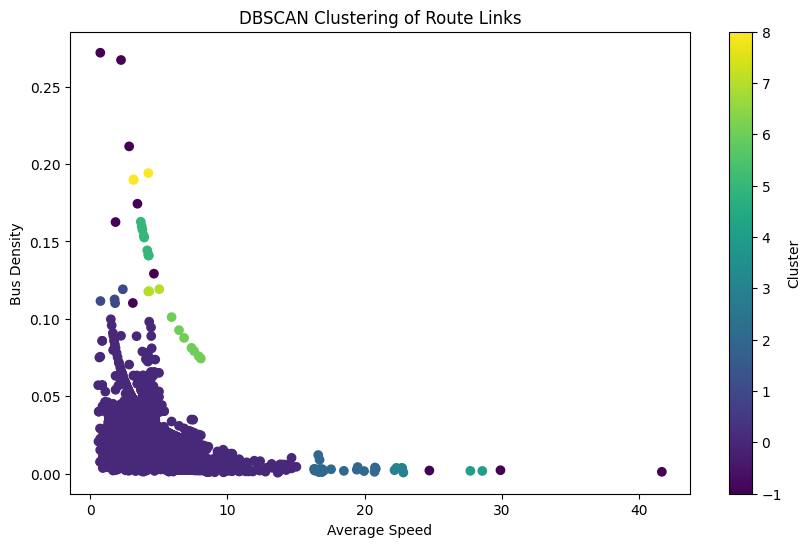

In [ ]:
# Initialize DBSCAN with chosen parameters
epsilon = 0.5  # Maximum distance between two samples for them to be considered as in the same neighborhood
min_samples = 2  # Minimum number of samples in a neighborhood for a point to be considered a core point
dbscan = DBSCAN(eps=epsilon, min_samples=min_samples)
avg_speed_df['DBSCAN Cluster'] = dbscan.fit_predict(features_scaled)

# Print the DataFrame with cluster labels
print("DataFrame with Clusters:")
print(avg_speed_df.head())

# Plot the clusters
plt.figure(figsize=(10, 6))
plt.scatter(avg_speed_df['AverageSpeed'], avg_speed_df['BusDensity'], c=avg_speed_df['DBSCAN Cluster'], cmap='viridis', marker='o')
plt.xlabel('Average Speed')
plt.ylabel('Bus Density')
plt.title('DBSCAN Clustering of Route Links')
plt.colorbar(label='Cluster')
plt.show()

In [ ]:
# Mark all the routes on the map and indicate the congestion level based on the color of the route
# Use the KNN clusters with k = 3

# Load the route links
routeLinks_df = pd.read_hdf('/content/drive/MyDrive/MSc Project Data/timetable_dataframes/routeLinks_df_processed.h5', key = 'df')

# Extract all coordinates to calculate the map's center
all_coords = [(coord[0], coord[1]) for track in routeLinks_df['Track(Longitude, Latitude)'] for coord in track]

# Calculate the map center
center_lat = sum(lat for lon, lat in all_coords) / len(all_coords)
center_lon = sum(lon for lon, lat in all_coords) / len(all_coords)

# Initialize the Folium map
mymap = folium.Map(location=[center_lat, center_lon], zoom_start=12)

# Define a list of colors
cluster_colors = ['red', 'yellow', 'blue'] #####################

# Add routes to the map with different colors for each Cluster
route_colors = {}
for idx, row in routeLinks_df.iterrows():
    route_section_id = row['RouteSectionId']

    track_coords = row['Track(Longitude, Latitude)']
    route_link_id = row['RouteLinkId']
    cluster = avg_speed_df.loc[avg_speed_df['RouteLinkId'] == route_link_id, 'KNN Cluster(k = 3)']

    if not cluster.empty:
      route_colors[route_section_id] = cluster_colors[cluster.values[0]] ##################
    else:
      continue

    # Draw the route link
    folium.PolyLine(
        locations=[(lat, lon) for lon, lat in track_coords],
        color=route_colors[route_section_id],
        weight=5,
        opacity=0.8,
        popup=f"RouteSectionId: {route_section_id}, RouteLinkId: {row['RouteLinkId']}"
    ).add_to(mymap)

# Save the map to an HTML file
mymap.save('/content/drive/MyDrive/MSc Project Data/congestion_map(timetable_data).html')

# Display the map
mymap

In [ ]:
# Calculate percentage of congestion on each route section

# Define the cluster number for congested routes
congested_cluster = 0

# Get the route section id based on the route link id
route_congestion_df = pd.merge(routeLinks_df[['RouteSectionId', 'RouteLinkId']], avg_speed_df, how = 'right', on = 'RouteLinkId')

# Calculate the total number of route links per RouteSectionId
total_links_per_section = route_congestion_df.groupby('RouteSectionId').size()

# Calculate the number of congested route links per RouteSectionId
congested_links_per_section = route_congestion_df[route_congestion_df['KNN Cluster(k = 3)'] == congested_cluster].groupby('RouteSectionId').size()

# Merge the two Series to align them by RouteSectionId
congestion_summary_df = pd.DataFrame({
    'TotalLinks': total_links_per_section,
    'CongestedLinks': congested_links_per_section.reindex(total_links_per_section.index, fill_value=0)
})

# Calculate the percentage of congested route links
congestion_summary_df['PercentageCongested'] = (congestion_summary_df['CongestedLinks'] / congestion_summary_df['TotalLinks']) * 100

# Reset index for a clean DataFrame output
congestion_summary_df = congestion_summary_df.reset_index()
congestion_summary_df

,RouteSectionId,TotalLinks,CongestedLinks,PercentageCongested
0,10:1,30,5,16.666667
1,10:3,32,3,9.375000
2,11:1,15,0,0.000000
3,11:4,19,0,0.000000
4,11A:1,22,0,0.000000
...,...,...,...,...
104,89:2,29,14,48.275862
105,8:2,36,0,0.000000
106,8:3,23,0,0.000000
107,9:1,21,0,0.000000


## Analysis based on actual location data

In [3]:
# Load the arrival times
arrivalTimes_df = pd.read_hdf('/content/drive/MyDrive/MSc Project Data/arrival_times.h5', key = 'df')

# Extract the time part from aimed departure and arrival time
arrivalTimes_df['AimedDepartureTime'] = pd.to_datetime(arrivalTimes_df['AimedDepartureTime'], format='%H:%M:%S').dt.time
arrivalTimes_df['AimedArrivalTime'] = pd.to_datetime(arrivalTimes_df['AimedArrivalTime'], format='%H:%M:%S').dt.time

arrivalTimes_df['ActualDepartureTime'] = pd.to_datetime(arrivalTimes_df['ActualDepartureTime'], format='%H:%M:%S')
arrivalTimes_df['ActualArrivalTime'] = pd.to_datetime(arrivalTimes_df['ActualArrivalTime'], format='%H:%M:%S')

arrivalTimes_df.describe(include = 'all')

,PublishedLineName,BlockRef,Day,VehicleJourneyRef,DestinationAimedArrivalTime,JourneyCode,FromStopPointRef,FromLocation,ToStopPointRef,ToLocation,AimedDepartureTime,AimedArrivalTime,ActualDepartureTime,ActualArrivalTime,RouteLinkId
count,1871806,1871806,1871806,1871806,1871806,1871806,1871806,1871806,1871806,1871806,1871806,1871806,1871806,1871806,1871806
unique,93,252,7,58274,NaN,810,1952,1973,1951,1965,1410,1413,NaN,NaN,7476
top,35,11034,Wednesday,NT26-In-4026-NT3300NS0496-2024-07-19T19:54:00-...,NaN,1010,3390H3,"(-1.1439376, 52.9552634)",3390J1,"(-1.1487437, 52.9574957)",15:35:00,15:27:00,NaN,NaN,34C:3_1_20986
freq,101606,28334,300083,136,NaN,16322,8963,8963,9263,9263,2461,2417,NaN,NaN,2188
mean,NaN,NaN,NaN,NaN,2024-07-26 03:45:38.065195264+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-07-26 03:27:31.174033408+01:00,2024-07-26 03:28:33.349928704+01:00,NaN
min,NaN,NaN,NaN,NaN,2024-07-18 22:27:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-07-18 22:44:10+01:00,2024-07-18 22:45:06+01:00,NaN
25%,NaN,NaN,NaN,NaN,2024-07-22 18:20:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-07-22 18:00:37+01:00,2024-07-22 18:01:37.249999872+01:00,NaN
50%,NaN,NaN,NaN,NaN,2024-07-25 21:22:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-07-25 21:08:00.500000+01:00,2024-07-25 21:09:00+01:00,NaN
75%,NaN,NaN,NaN,NaN,2024-07-29 18:19:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-07-29 17:58:56+01:00,2024-07-29 18:00:14+01:00,NaN
max,NaN,NaN,NaN,NaN,2024-08-01 23:44:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-01 20:58:51+01:00,2024-08-01 20:58:51+01:00,NaN


In [4]:
arrivalTimes_df.head()

,PublishedLineName,BlockRef,Day,VehicleJourneyRef,DestinationAimedArrivalTime,JourneyCode,FromStopPointRef,FromLocation,ToStopPointRef,ToLocation,AimedDepartureTime,AimedArrivalTime,ActualDepartureTime,ActualArrivalTime,RouteLinkId
0,1,1001,Friday,NT1-In-1001-NT260007454-2024-07-19T06:36:00-20...,2024-07-19 07:37:00+01:00,1021,260007454,"(-1.2052472, 52.7720907)",260007423,"(-1.202979, 52.7731152)",06:36:00,06:36:00,2024-07-19 06:22:54+01:00,2024-07-19 06:36:50+01:00,1:1_1_2147483284
1,1,1001,Friday,NT1-In-1001-NT260007454-2024-07-19T06:36:00-20...,2024-07-19 07:37:00+01:00,1021,260007423,"(-1.202979, 52.7731152)",260007343,"(-1.1997359, 52.7754058)",06:36:00,06:37:00,2024-07-19 06:36:50+01:00,2024-07-19 06:37:28+01:00,1:1_2_2147483283
2,1,1001,Friday,NT1-In-1001-NT260007454-2024-07-19T06:36:00-20...,2024-07-19 07:37:00+01:00,1021,260007343,"(-1.1997359, 52.7754058)",260007462,"(-1.1981939, 52.7799255)",06:37:00,06:38:00,2024-07-19 06:37:28+01:00,2024-07-19 06:38:43+01:00,1:1_3_2147483509
3,1,1001,Friday,NT1-In-1001-NT260007454-2024-07-19T06:36:00-20...,2024-07-19 07:37:00+01:00,1021,260007462,"(-1.1981939, 52.7799255)",260007307,"(-1.199306, 52.7806892)",06:38:00,06:38:00,2024-07-19 06:38:43+01:00,2024-07-19 06:39:16+01:00,1:1_4_2147483505
4,1,1001,Friday,NT1-In-1001-NT260007454-2024-07-19T06:36:00-20...,2024-07-19 07:37:00+01:00,1021,260007307,"(-1.199306, 52.7806892)",260007487,"(-1.2008953, 52.7811516)",06:38:00,06:39:00,2024-07-19 06:39:16+01:00,2024-07-19 06:39:16+01:00,1:1_5_3425


In [5]:
# Handle all the rows where the actual journey start time is before the aimed journey start time

# Get journey start time for each journey
journey_start_time = arrivalTimes_df['VehicleJourneyRef'].apply(lambda x: x.split('T')[-1])
journey_start_time = pd.to_datetime(journey_start_time + ' +01:00', format = '%H:%M:%S-%Y-%m-%d %z')

# Replace ActualDepartureTime with journey_start_time where needed
def update_departure_time(row):
    new_departure_time = journey_start_time.iloc[row.name]
    old_departure_time = row['ActualDepartureTime']
    arrival_time = row['ActualArrivalTime']

    # Check the conditions:
    # If actual departure time is before it aimed to depart
    if new_departure_time > old_departure_time:
      # If aimed departure time is before the arrival time
      if new_departure_time > arrival_time:
          # If difference between aimed departure and actual departure is more than 4 minutes and the routelink is the first in the routesection
          if ((new_departure_time - old_departure_time) > pd.Timedelta(seconds = 240)) & (row['RouteLinkId'].split('_')[1] == '1'):

              # Convert aimed departure and arrival times to datetime objects with a reference date
              reference_date = pd.Timestamp('1970-01-01')
              aimed_departure_datetime = pd.Timestamp.combine(reference_date, row['AimedDepartureTime'])
              aimed_arrival_datetime = pd.Timestamp.combine(reference_date, row['AimedArrivalTime'])

              # Calculate required run time as timedelta
              required_run_time = aimed_arrival_datetime - aimed_departure_datetime

              if required_run_time == pd.Timedelta(seconds = 0):
                  return arrival_time - pd.Timedelta(seconds = 30)
              else:
                  return arrival_time - required_run_time
          # do not update
          return old_departure_time
      # If the run time in case of updated departure is less than 30 seconds
      if (arrival_time - new_departure_time) < pd.Timedelta(seconds=30):
          # If the gap between arrival time and new departure time is less than 30 seconds
          if (new_departure_time - old_departure_time) < pd.Timedelta(seconds=60):
              # If the gap between old and new departure time is less than 60 seconds
              return old_departure_time
    else:
      return old_departure_time

    # Otherwise, update departure time
    return new_departure_time

# Apply the function to each row
arrivalTimes_df['ActualDepartureTime'] = arrivalTimes_df.apply(update_departure_time, axis=1)

# Remove the rows where arrival time is before the departure time
arrivalTimes_df = arrivalTimes_df[arrivalTimes_df['ActualDepartureTime'] <= arrivalTimes_df['ActualArrivalTime']]

arrivalTimes_df.describe(include = 'all')

,PublishedLineName,BlockRef,Day,VehicleJourneyRef,DestinationAimedArrivalTime,JourneyCode,FromStopPointRef,FromLocation,ToStopPointRef,ToLocation,AimedDepartureTime,AimedArrivalTime,ActualDepartureTime,ActualArrivalTime,RouteLinkId
count,1832217,1832217,1832217,1832217,1832217,1832217,1832217,1832217,1832217,1832217,1832217,1832217,1832217,1832217,1832217
unique,93,252,7,58225,NaN,810,1952,1969,1951,1965,1409,1413,561109,NaN,7423
top,35,11034,Wednesday,NT26-In-4026-NT3300NS0496-2024-07-19T19:54:00-...,NaN,1010,3390H3,"(-1.1439376, 52.9552634)",3390J1,"(-1.1487437, 52.9574957)",15:15:00,13:31:00,2024-07-18 22:45:35+01:00,NaN,34C:3_1_20986
freq,100019,25748,293728,133,NaN,16143,8669,8669,8801,8801,2438,2387,180,NaN,2186
mean,NaN,NaN,NaN,NaN,2024-07-26 03:48:48.605935104+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-07-26 03:31:52.723073792+01:00,NaN
min,NaN,NaN,NaN,NaN,2024-07-18 22:27:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-07-18 22:45:06+01:00,NaN
25%,NaN,NaN,NaN,NaN,2024-07-22 18:20:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-07-22 18:01:43+01:00,NaN
50%,NaN,NaN,NaN,NaN,2024-07-25 21:23:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-07-25 21:10:12+01:00,NaN
75%,NaN,NaN,NaN,NaN,2024-07-29 18:20:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-07-29 18:01:12+01:00,NaN
max,NaN,NaN,NaN,NaN,2024-08-01 23:44:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-01 20:58:51+01:00,NaN


In [6]:
arrivalTimes_df[(arrivalTimes_df['PublishedLineName'] == '3') & (arrivalTimes_df['Day'] == 'Thursday') & (arrivalTimes_df['JourneyCode'] == '1082')].head()

,PublishedLineName,BlockRef,Day,VehicleJourneyRef,DestinationAimedArrivalTime,JourneyCode,FromStopPointRef,FromLocation,ToStopPointRef,ToLocation,AimedDepartureTime,AimedArrivalTime,ActualDepartureTime,ActualArrivalTime,RouteLinkId
504635,3,53003,Thursday,NT3-Out-53003-NT3390B2-2024-07-25T17:45:00-202...,2024-07-25 18:33:00+01:00,1082,3390B2,"(-1.1513667, 52.9533205)",3390M2,"(-1.1529839, 52.9522257)",17:45:00,17:46:00,2024-07-25 17:45:10+01:00,2024-07-25 17:49:21+01:00,3:11_1_2147483234
504636,3,53003,Thursday,NT3-Out-53003-NT3390B2-2024-07-25T17:45:00-202...,2024-07-25 18:33:00+01:00,1082,3390M2,"(-1.1529839, 52.9522257)",3390C2,"(-1.1493806, 52.94862)",17:46:00,17:47:00,2024-07-25 17:49:21+01:00,2024-07-25 17:51:01+01:00,3:11_2_12589
504637,3,53003,Thursday,NT3-Out-53003-NT3390B2-2024-07-25T17:45:00-202...,2024-07-25 18:33:00+01:00,1082,3390C2,"(-1.1493806, 52.94862)",3390S2,"(-1.147587, 52.9478946)",17:47:00,17:50:00,2024-07-25 17:51:01+01:00,2024-07-25 17:51:40+01:00,3:11_3_2147480598
504638,3,53003,Thursday,NT3-Out-53003-NT3390B2-2024-07-25T17:45:00-202...,2024-07-25 18:33:00+01:00,1082,3390S2,"(-1.147587, 52.9478946)",3390ME01,"(-1.14670255151079, 52.94601864708672)",17:50:00,17:50:00,2024-07-25 17:51:40+01:00,2024-07-25 17:54:33+01:00,3:11_4_2147483231
504639,3,53003,Thursday,NT3-Out-53003-NT3390B2-2024-07-25T17:45:00-202...,2024-07-25 18:33:00+01:00,1082,3390ME01,"(-1.14670255151079, 52.94601864708672)",3390ME02,"(-1.1431284, 52.944636)",17:50:00,17:51:00,2024-07-25 17:54:33+01:00,2024-07-25 17:55:16+01:00,3:11_5_2147483230


In [7]:
# Load the route links
routeLinks_df = pd.read_hdf('/content/drive/MyDrive/MSc Project Data/timetable_dataframes/routeLinks_df_processed.h5', key = 'df')

# Get the track for each route link of the buses
arrivalTimes_df = pd.merge(arrivalTimes_df, routeLinks_df[['RouteLinkId', 'Track(Longitude, Latitude)', 'TrackDistance']], how = 'left', on = 'RouteLinkId')

# Calculate the run time and speed
arrivalTimes_df['RunTime'] = arrivalTimes_df['ActualArrivalTime'] - arrivalTimes_df['ActualDepartureTime']
arrivalTimes_df['RunTime'] = arrivalTimes_df['RunTime'].apply(lambda x: x.total_seconds())
arrivalTimes_df['RunTime'] = arrivalTimes_df['RunTime'].apply(lambda x: max(x, 0))
arrivalTimes_df['Speed'] = arrivalTimes_df.apply(lambda row: row['TrackDistance'] / row['RunTime'] if row['RunTime'] != 0 else None, axis=1)

# Group by multiple columns and fill NaN values in 'Speed' with the mean speed of each group
arrivalTimes_df['Speed'] = arrivalTimes_df.groupby(['PublishedLineName', 'Day', 'JourneyCode'])['Speed'].transform(
    lambda x: x.fillna(x.mean())
)

# Save as hdf file
arrivalTimes_df.to_hdf('/content/drive/MyDrive/MSc Project Data/arrival_times_processed.h5', key='df', mode='w')


<ipython-input-7-e98ee7696306>:8: PerformanceWarning: Adding/subtracting object-dtype array to DatetimeArray not vectorized.
  arrivalTimes_df['RunTime'] = arrivalTimes_df['ActualArrivalTime'] - arrivalTimes_df['ActualDepartureTime']
<ipython-input-7-e98ee7696306>:19: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed,key->block3_values] [items->Index(['PublishedLineName', 'BlockRef', 'Day', 'VehicleJourneyRef',
       'JourneyCode', 'FromStopPointRef', 'FromLocation', 'ToStopPointRef',
       'ToLocation', 'AimedDepartureTime', 'AimedArrivalTime',
       'ActualDepartureTime', 'RouteLinkId', 'Track(Longitude, Latitude)'],
      dtype='object')]

  arrivalTimes_df.to_hdf('/content/drive/MyDrive/MSc Project Data/arrival_times_processed.h5', key='df', mode='w')


In [8]:
# Load the processed arrival times
arrivalTimes_df = pd.read_hdf('/content/drive/MyDrive/MSc Project Data/arrival_times_processed.h5', key = 'df')

arrivalTimes_df.describe(include = 'all')
arrivalTimes_df.head()

,PublishedLineName,BlockRef,Day,VehicleJourneyRef,DestinationAimedArrivalTime,JourneyCode,FromStopPointRef,FromLocation,ToStopPointRef,ToLocation,AimedDepartureTime,AimedArrivalTime,ActualDepartureTime,ActualArrivalTime,RouteLinkId,"Track(Longitude, Latitude)",TrackDistance,RunTime,Speed
0,1,1001,Friday,NT1-In-1001-NT260007454-2024-07-19T06:36:00-20...,2024-07-19 07:37:00+01:00,1021,260007454,"(-1.2052472, 52.7720907)",260007423,"(-1.202979, 52.7731152)",06:36:00,06:36:00,2024-07-19 06:36:00+01:00,2024-07-19 06:36:50+01:00,1:1_1_2147483284,"((-1.2052472, 52.7720907), (-1.204838, 52.7722...",196.340042,50.0,3.926801
1,1,1001,Friday,NT1-In-1001-NT260007454-2024-07-19T06:36:00-20...,2024-07-19 07:37:00+01:00,1021,260007423,"(-1.202979, 52.7731152)",260007343,"(-1.1997359, 52.7754058)",06:36:00,06:37:00,2024-07-19 06:36:50+01:00,2024-07-19 06:37:28+01:00,1:1_2_2147483283,"((-1.202979, 52.7731152), (-1.202935, 52.77308...",347.029781,38.0,9.132363
2,1,1001,Friday,NT1-In-1001-NT260007454-2024-07-19T06:36:00-20...,2024-07-19 07:37:00+01:00,1021,260007343,"(-1.1997359, 52.7754058)",260007462,"(-1.1981939, 52.7799255)",06:37:00,06:38:00,2024-07-19 06:37:28+01:00,2024-07-19 06:38:43+01:00,1:1_3_2147483509,"((-1.1997359, 52.7754058), (-1.199463, 52.7755...",645.061123,75.0,8.600815
3,1,1001,Friday,NT1-In-1001-NT260007454-2024-07-19T06:36:00-20...,2024-07-19 07:37:00+01:00,1021,260007462,"(-1.1981939, 52.7799255)",260007307,"(-1.199306, 52.7806892)",06:38:00,06:38:00,2024-07-19 06:38:43+01:00,2024-07-19 06:39:16+01:00,1:1_4_2147483505,"((-1.1981939, 52.7799255), (-1.198239, 52.7799...",114.396405,33.0,3.466558
4,1,1001,Friday,NT1-In-1001-NT260007454-2024-07-19T06:36:00-20...,2024-07-19 07:37:00+01:00,1021,260007307,"(-1.199306, 52.7806892)",260007487,"(-1.2008953, 52.7811516)",06:38:00,06:39:00,2024-07-19 06:39:16+01:00,2024-07-19 06:39:16+01:00,1:1_5_3425,"((-1.199306, 52.7806892), (-1.199596, 52.78083...",120.877723,0.0,8.163127


In [9]:
# Calculate the average speed and bus density based on day and time

def calculate_avg_speed(day, start_time, end_time, no_constraints, only_day):
  # Extract data after applying the constraints
  if no_constraints:
    avg_speed_df = arrivalTimes_df.copy()
  elif only_day:
    avg_speed_df = arrivalTimes_df[arrivalTimes_df['Day'] == day].copy()
  else:
    avg_speed_df = arrivalTimes_df[
        (arrivalTimes_df['Day'] == day) &
        (arrivalTimes_df['ActualDepartureTime'].apply(lambda x: x.time()) >= start_time) &
        (arrivalTimes_df['ActualDepartureTime'].apply(lambda x: x.time()) <= end_time) &
        (arrivalTimes_df['ActualArrivalTime'].apply(lambda x: x.time()) >= start_time) &
        (arrivalTimes_df['ActualArrivalTime'].apply(lambda x: x.time()) <= end_time)
    ].copy()

  # Drop na
  avg_speed_df = avg_speed_df.dropna()

  # Create BusCount column by counting the number of rows in each RouteLinkId group
  avg_speed_df['BusCount'] = avg_speed_df.groupby('RouteLinkId')['RouteLinkId'].transform('count')

  # Calculate the average distance, speed and bus count for each route link
  avg_speed_df = avg_speed_df.groupby('RouteLinkId').agg({
      'TrackDistance': 'mean',
      'Speed': 'mean',
      'BusCount': 'mean'
  }).reset_index()

  # Calculate the bus density using the formula (bus count / track distance)
  avg_speed_df['BusDensity'] = avg_speed_df.apply(lambda row: row['BusCount'] / row['TrackDistance'], axis=1)

  # Rename the speed column as average speed
  avg_speed_df.rename(columns={'Speed': 'AverageSpeed'}, inplace=True)
  return avg_speed_df


In [10]:
# Define the constraints
day = 'Thursday'
start_time = pd.to_datetime('12:00:00').time()
end_time = pd.to_datetime('14:00:00').time()
no_constraints = True
only_day = False

avg_speed_df = calculate_avg_speed(day, start_time, end_time, no_constraints, only_day)
avg_speed_df.head()

,RouteLinkId,TrackDistance,AverageSpeed,BusCount,BusDensity
0,10:1_10_2147481803,345.284223,7.835026,565.0,1.636333
1,10:1_11_2147481802,186.169580,7.105317,563.0,3.024125
2,10:1_12_2147481801,324.205438,8.107303,556.0,1.714962
3,10:1_13_2147481800,397.139085,6.732494,543.0,1.367279
4,10:1_14_2147481799,260.830928,4.893797,543.0,2.081808


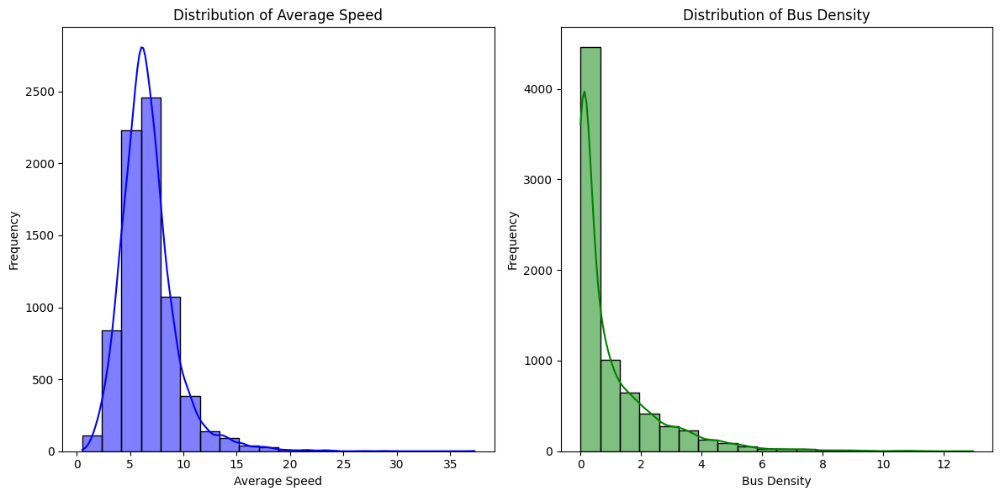

In [11]:
# Plot the distribution of AverageSpeed and BusDensity
plt.figure(figsize=(12, 6))

# Histogram and KDE for AverageSpeed
plt.subplot(1, 2, 1)
sns.histplot(avg_speed_df['AverageSpeed'], bins=20, kde=True, color='blue')
plt.title('Distribution of Average Speed')
plt.xlabel('Average Speed')
plt.ylabel('Frequency')

# Histogram and KDE for BusDensity
plt.subplot(1, 2, 2)
sns.histplot(avg_speed_df['BusDensity'], bins=20, kde=True, color='green')
plt.title('Distribution of Bus Density')
plt.xlabel('Bus Density')
plt.ylabel('Frequency')

# Adjust layout
plt.tight_layout()
plt.show()


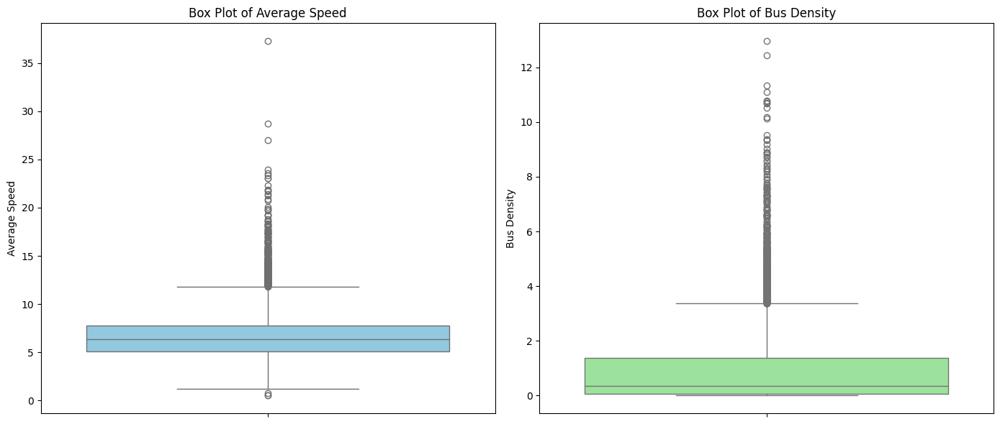

In [12]:
# Box plots for average speed and bus density

# Set up the plotting area
plt.figure(figsize=(14, 6))

# Box plot for AverageSpeed
plt.subplot(1, 2, 1)
sns.boxplot(y=avg_speed_df['AverageSpeed'], color='skyblue')
plt.title('Box Plot of Average Speed')
plt.ylabel('Average Speed')

# Box plot for BusDensity
plt.subplot(1, 2, 2)
sns.boxplot(y=avg_speed_df['BusDensity'], color='lightgreen')
plt.title('Box Plot of Bus Density')
plt.ylabel('Bus Density')

# Adjust layout
plt.tight_layout()
plt.show()


In [13]:
def remove_outliers(avg_speed_df):
  # Calculate z-scores
  z_scores = np.abs(stats.zscore(avg_speed_df[['AverageSpeed']]))

  # Set a threshold for identifying outliers
  threshold = 5

  # Identify outliers
  outliers = (z_scores > threshold).any(axis=1)

  # Remove outliers
  avg_speed_df = avg_speed_df[~outliers]
  return avg_speed_df

In [14]:
avg_speed_df = remove_outliers(avg_speed_df)

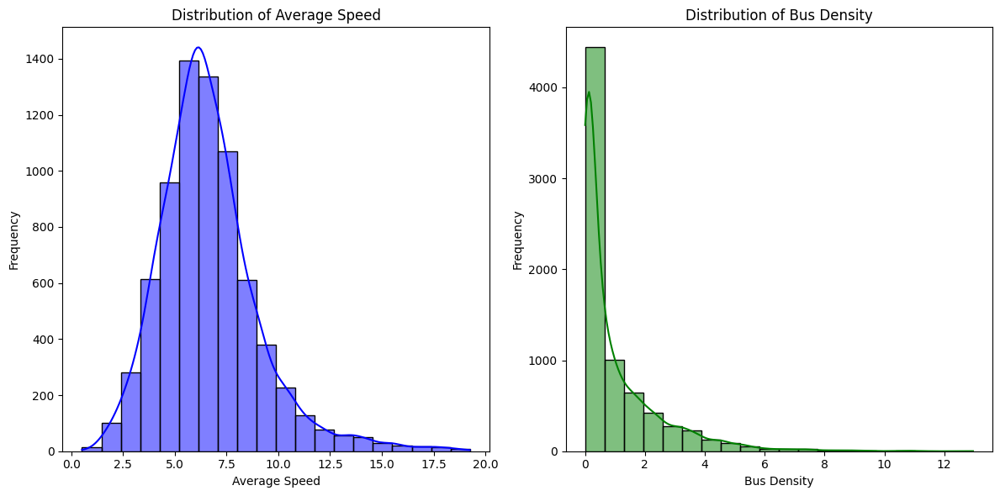

In [15]:
# Plot the distribution of AverageSpeed and BusDensity
plt.figure(figsize=(12, 6))

# Histogram and KDE for AverageSpeed
plt.subplot(1, 2, 1)
sns.histplot(avg_speed_df['AverageSpeed'], bins=20, kde=True, color='blue')
plt.title('Distribution of Average Speed')
plt.xlabel('Average Speed')
plt.ylabel('Frequency')

# Histogram and KDE for BusDensity
plt.subplot(1, 2, 2)
sns.histplot(avg_speed_df['BusDensity'], bins=20, kde=True, color='green')
plt.title('Distribution of Bus Density')
plt.xlabel('Bus Density')
plt.ylabel('Frequency')

# Adjust layout
plt.tight_layout()
plt.show()


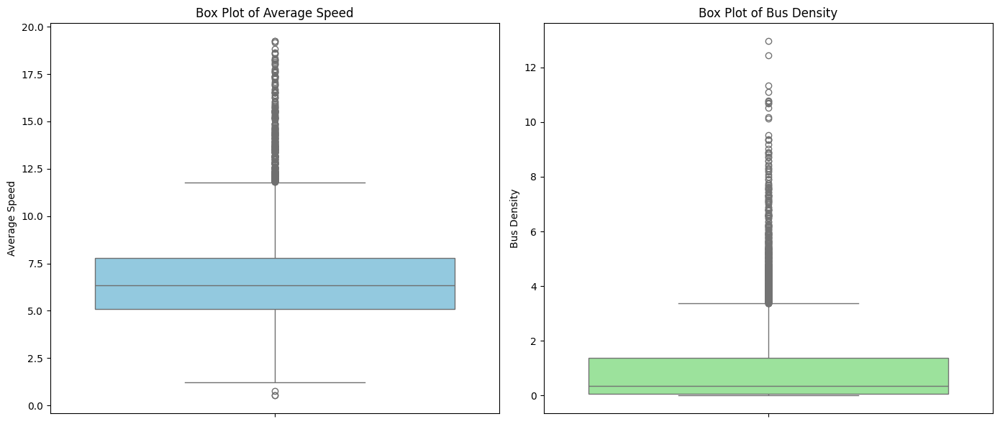

In [16]:
# Box plots for average speed and bus density

# Set up the plotting area
plt.figure(figsize=(14, 6))

# Box plot for AverageSpeed
plt.subplot(1, 2, 1)
sns.boxplot(y=avg_speed_df['AverageSpeed'], color='skyblue')
plt.title('Box Plot of Average Speed')
plt.ylabel('Average Speed')

# Box plot for BusDensity
plt.subplot(1, 2, 2)
sns.boxplot(y=avg_speed_df['BusDensity'], color='lightgreen')
plt.title('Box Plot of Bus Density')
plt.ylabel('Bus Density')

# Adjust layout
plt.tight_layout()
plt.show()


In [17]:
# KNN Classification

# Features to use for k-NN
features = avg_speed_df[['AverageSpeed', 'BusDensity']]

# Normalize the features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Cluster Centers:
[[ 0.09252681 -0.37841211]
 [-0.43399989  1.7749538 ]]

DataFrame with Clusters:
          RouteLinkId  TrackDistance  AverageSpeed  BusCount  BusDensity  \
0  10:1_10_2147481803     345.284223      7.835026     565.0    1.636333   
1  10:1_11_2147481802     186.169580      7.105317     563.0    3.024125   
2  10:1_12_2147481801     324.205438      8.107303     556.0    1.714962   
3  10:1_13_2147481800     397.139085      6.732494     543.0    1.367279   
4  10:1_14_2147481799     260.830928      4.893797     543.0    2.081808   

   KNN Cluster(k = 2)  
0                   0  
1                   1  
2                   0  
3                   0  
4                   1  


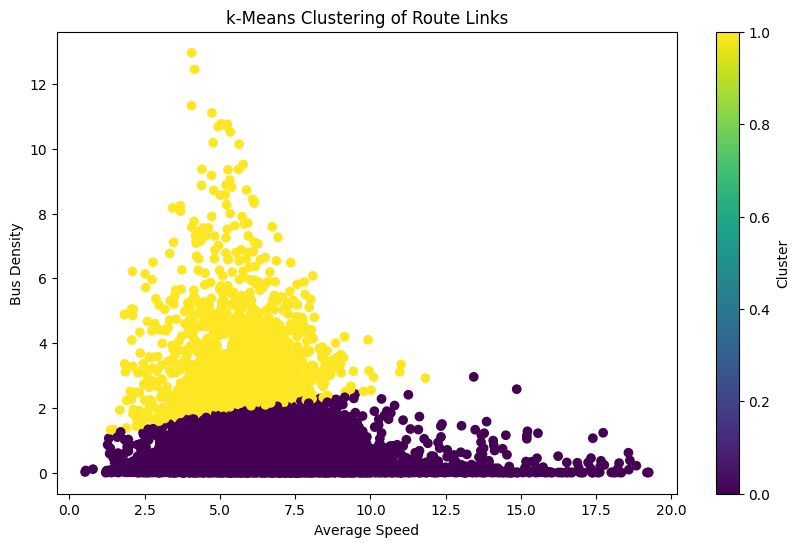

In [18]:
# Initialize k-Means with a chosen number of clusters
k = 2  # Number of clusters
kmeans = KMeans(n_clusters=k, random_state=42)
avg_speed_df['KNN Cluster(k = ' + str(k) + ')'] = kmeans.fit_predict(features_scaled)

# Print cluster centers
print("Cluster Centers:")
print(kmeans.cluster_centers_)

# Print the DataFrame with cluster labels
print("\nDataFrame with Clusters:")
print(avg_speed_df.head())

# Optional: Plot the clusters
plt.figure(figsize=(10, 6))
plt.scatter(avg_speed_df['AverageSpeed'], avg_speed_df['BusDensity'], c=avg_speed_df['KNN Cluster(k = ' + str(k) + ')'], cmap='viridis', marker='o')
plt.xlabel('Average Speed')
plt.ylabel('Bus Density')
plt.title('k-Means Clustering of Route Links')
plt.colorbar(label='Cluster')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Cluster Centers:
[[-0.43569074 -0.3111617 ]
 [ 1.30894265 -0.43808486]
 [-0.38905518  1.94226641]]

DataFrame with Clusters:
          RouteLinkId  TrackDistance  AverageSpeed  BusCount  BusDensity  \
0  10:1_10_2147481803     345.284223      7.835026     565.0    1.636333   
1  10:1_11_2147481802     186.169580      7.105317     563.0    3.024125   
2  10:1_12_2147481801     324.205438      8.107303     556.0    1.714962   
3  10:1_13_2147481800     397.139085      6.732494     543.0    1.367279   
4  10:1_14_2147481799     260.830928      4.893797     543.0    2.081808   

   KNN Cluster(k = 2)  KNN Cluster(k = 3)  
0                   0                   0  
1                   1                   2  
2                   0                   1  
3                   0                   0  
4                   1                   0  


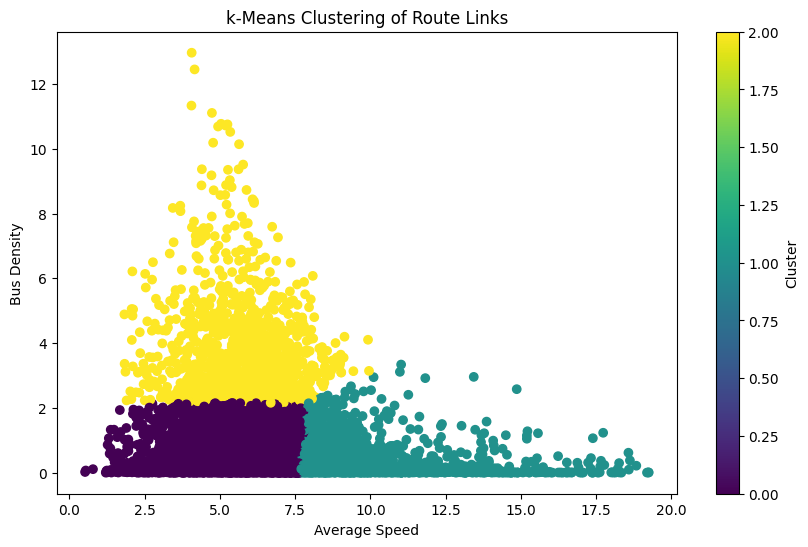

In [19]:
# Initialize k-Means with a chosen number of clusters
k = 3  # Number of clusters
kmeans = KMeans(n_clusters=k, random_state=42)
avg_speed_df['KNN Cluster(k = ' + str(k) + ')'] = kmeans.fit_predict(features_scaled)

# Print cluster centers
print("Cluster Centers:")
centers = kmeans.cluster_centers_
print(centers)

# Get the cluster numbers according to congestion
low_congestion_cluster = np.argmax(centers[:, 0])
high_congestion_cluster = np.argmax(centers[:, 1])
# Determine medium congestion cluster (remaining cluster)
all_clusters = {0, 1, 2}
medium_congestion_cluster = list(all_clusters - {low_congestion_cluster, high_congestion_cluster})[0]

# Print the DataFrame with cluster labels
print("\nDataFrame with Clusters:")
print(avg_speed_df.head())

# Optional: Plot the clusters
plt.figure(figsize=(10, 6))
plt.scatter(avg_speed_df['AverageSpeed'], avg_speed_df['BusDensity'], c=avg_speed_df['KNN Cluster(k = ' + str(k) + ')'], cmap='viridis', marker='o')
plt.xlabel('Average Speed')
plt.ylabel('Bus Density')
plt.title('k-Means Clustering of Route Links')
plt.colorbar(label='Cluster')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Cluster Centers:
[[ 2.15477909 -0.5271716 ]
 [-0.37912023  1.98621371]
 [ 0.3191161  -0.31660103]
 [-0.84474821 -0.31405979]]

DataFrame with Clusters:
          RouteLinkId  TrackDistance  AverageSpeed  BusCount  BusDensity  \
0  10:1_10_2147481803     345.284223      7.835026     565.0    1.636333   
1  10:1_11_2147481802     186.169580      7.105317     563.0    3.024125   
2  10:1_12_2147481801     324.205438      8.107303     556.0    1.714962   
3  10:1_13_2147481800     397.139085      6.732494     543.0    1.367279   
4  10:1_14_2147481799     260.830928      4.893797     543.0    2.081808   

   KNN Cluster(k = 2)  KNN Cluster(k = 3)  KNN Cluster(k = 4)  
0                   0                   0                   2  
1                   1                   2                   1  
2                   0                   1                   2  
3                   0                   0                   2  
4                   1                   0                   3  


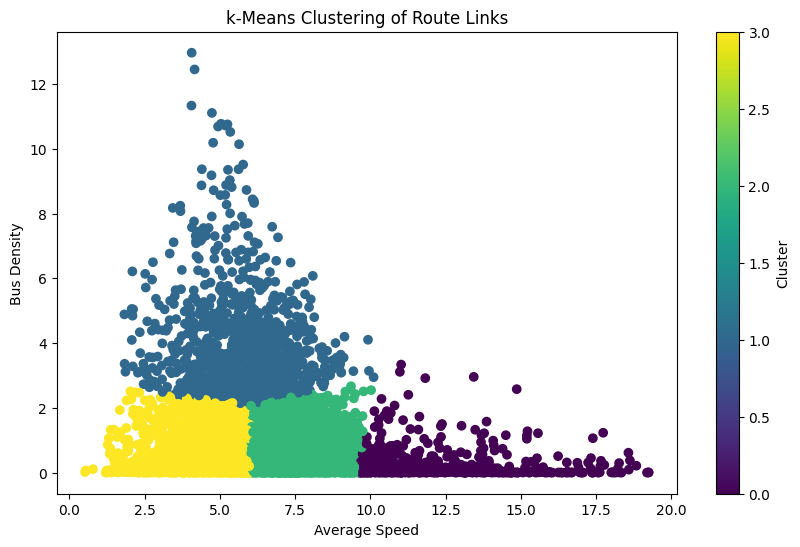

In [20]:
# Initialize k-Means with a chosen number of clusters
k = 4  # Number of clusters
kmeans = KMeans(n_clusters=k, random_state=42)
avg_speed_df['KNN Cluster(k = ' + str(k) + ')'] = kmeans.fit_predict(features_scaled)

# Print cluster centers
print("Cluster Centers:")
print(kmeans.cluster_centers_)

# Print the DataFrame with cluster labels
print("\nDataFrame with Clusters:")
print(avg_speed_df.head())

# Optional: Plot the clusters
plt.figure(figsize=(10, 6))
plt.scatter(avg_speed_df['AverageSpeed'], avg_speed_df['BusDensity'], c=avg_speed_df['KNN Cluster(k = ' + str(k) + ')'], cmap='viridis', marker='o')
plt.xlabel('Average Speed')
plt.ylabel('Bus Density')
plt.title('k-Means Clustering of Route Links')
plt.colorbar(label='Cluster')
plt.show()

In [21]:
avg_speed_df.head()

,RouteLinkId,TrackDistance,AverageSpeed,BusCount,BusDensity,KNN Cluster(k = 2),KNN Cluster(k = 3),KNN Cluster(k = 4)
0,10:1_10_2147481803,345.284223,7.835026,565.0,1.636333,0,0,2
1,10:1_11_2147481802,186.169580,7.105317,563.0,3.024125,1,2,1
2,10:1_12_2147481801,324.205438,8.107303,556.0,1.714962,0,1,2
3,10:1_13_2147481800,397.139085,6.732494,543.0,1.367279,0,0,2
4,10:1_14_2147481799,260.830928,4.893797,543.0,2.081808,1,0,3


DataFrame with Clusters:
          RouteLinkId  TrackDistance  AverageSpeed  BusCount  BusDensity  \
0  10:1_10_2147481803     345.284223      7.835026     565.0    1.636333   
1  10:1_11_2147481802     186.169580      7.105317     563.0    3.024125   
2  10:1_12_2147481801     324.205438      8.107303     556.0    1.714962   
3  10:1_13_2147481800     397.139085      6.732494     543.0    1.367279   
4  10:1_14_2147481799     260.830928      4.893797     543.0    2.081808   

   KNN Cluster(k = 2)  KNN Cluster(k = 3)  KNN Cluster(k = 4)  DBSCAN Cluster  
0                   0                   0                   2               0  
1                   1                   2                   1               0  
2                   0                   1                   2               0  
3                   0                   0                   2               0  
4                   1                   0                   3               0  


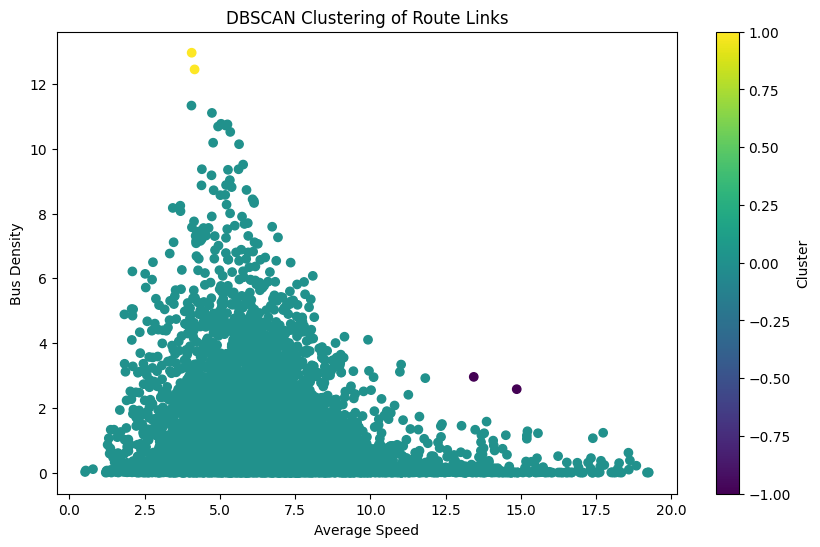

In [22]:
# Initialize DBSCAN with chosen parameters
epsilon = 0.5  # Maximum distance between two samples for them to be considered as in the same neighborhood
min_samples = 2  # Minimum number of samples in a neighborhood for a point to be considered a core point
dbscan = DBSCAN(eps=epsilon, min_samples=min_samples)
avg_speed_df['DBSCAN Cluster'] = dbscan.fit_predict(features_scaled)

# Print the DataFrame with cluster labels
print("DataFrame with Clusters:")
print(avg_speed_df.head())

# Plot the clusters
plt.figure(figsize=(10, 6))
plt.scatter(avg_speed_df['AverageSpeed'], avg_speed_df['BusDensity'], c=avg_speed_df['DBSCAN Cluster'], cmap='viridis', marker='o')
plt.xlabel('Average Speed')
plt.ylabel('Bus Density')
plt.title('DBSCAN Clustering of Route Links')
plt.colorbar(label='Cluster')
plt.show()

Number of Route Links in Each Category:
High Congestion: 1128
Medium Congestion: 4454
Low Congestion: 1810


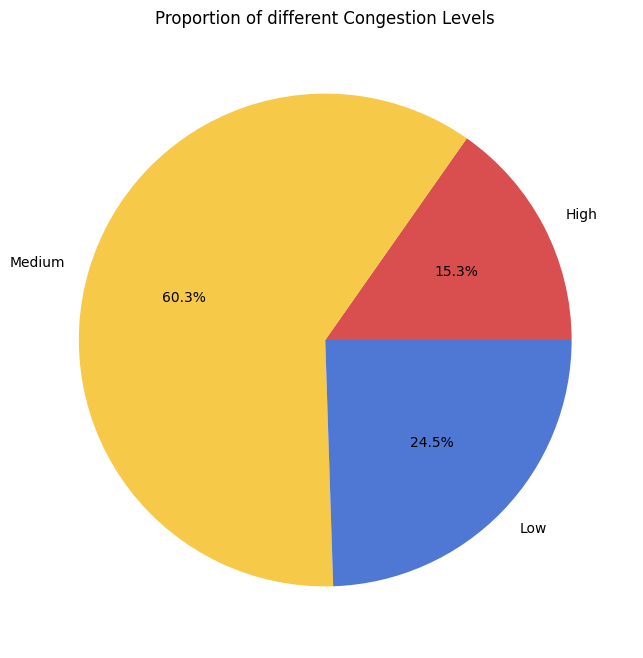

In [23]:
# Calculate the proportions of low, medium and high congestion routeLinks
high_congestion_count = avg_speed_df[avg_speed_df['KNN Cluster(k = 3)'] == high_congestion_cluster].shape[0]
medium_congestion_count = avg_speed_df[avg_speed_df['KNN Cluster(k = 3)'] == medium_congestion_cluster].shape[0]
low_congestion_count = avg_speed_df[avg_speed_df['KNN Cluster(k = 3)'] == low_congestion_cluster].shape[0]

print('Number of Route Links in Each Category:')
print('High Congestion:', high_congestion_count)
print('Medium Congestion:', medium_congestion_count)
print('Low Congestion:', low_congestion_count)

# Pie chart for congestion distribution
plt.figure(figsize=(8, 8))
plt.pie([high_congestion_count, medium_congestion_count, low_congestion_count], labels=['High', 'Medium', 'Low'], autopct='%1.1f%%', colors=['#d94f4f', '#f7c948', '#4f77d4'])
plt.title('Proportion of different Congestion Levels')
plt.show()


In [24]:
# Mark all the routes on the map and indicate the congestion level based on the color of the route
# Use the KNN clusters with k = 3

# Load the route links
routeLinks_df = pd.read_hdf('/content/drive/MyDrive/MSc Project Data/timetable_dataframes/routeLinks_df_processed.h5', key = 'df')

# Extract all coordinates to calculate the map's center
all_coords = [(coord[0], coord[1]) for track in routeLinks_df['Track(Longitude, Latitude)'] for coord in track]

# Calculate the map center
center_lat = sum(lat for lon, lat in all_coords) / len(all_coords)
center_lon = sum(lon for lon, lat in all_coords) / len(all_coords)

# Initialize the Folium map
mymap = folium.Map(location=[center_lat, center_lon], zoom_start=12)

# Define a list of colors
cluster_colors = [None, None, None]
cluster_colors[low_congestion_cluster] = 'blue'
cluster_colors[medium_congestion_cluster] = 'yellow'
cluster_colors[high_congestion_cluster] = 'red'

# Add routes to the map with different colors for each Cluster
route_colors = {}
for idx, row in routeLinks_df.iterrows():
    route_section_id = row['RouteSectionId']

    track_coords = row['Track(Longitude, Latitude)']
    route_link_id = row['RouteLinkId']
    cluster = avg_speed_df.loc[avg_speed_df['RouteLinkId'] == route_link_id, 'KNN Cluster(k = 3)']

    if not cluster.empty:
      route_colors[route_section_id] = cluster_colors[cluster.values[0]] ##################
    else:
      continue

    # Draw the route link
    folium.PolyLine(
        locations=[(lat, lon) for lon, lat in track_coords],
        color=route_colors[route_section_id],
        weight=5,
        opacity=0.8,
        popup=f"RouteSectionId: {route_section_id}, RouteLinkId: {row['RouteLinkId']}"
    ).add_to(mymap)

# Save the map to an HTML file
mymap.save('/content/drive/MyDrive/MSc Project Data/congestion_map(location_data).html')

# Display the map
mymap

In [25]:
# Calculate percentage of congestion on each route section

def get_congestion_summary(avg_speed_df, congested_cluster):

  routeLinks_df = pd.read_hdf('/content/drive/MyDrive/MSc Project Data/timetable_dataframes/routeLinks_df_processed.h5', key = 'df')

  # Get the route section id based on the route link id
  route_congestion_df = pd.merge(routeLinks_df[['RouteSectionId', 'RouteLinkId']], avg_speed_df, how = 'right', on = 'RouteLinkId')

  # Calculate the total number of route links per RouteSectionId
  total_links_per_section = route_congestion_df.groupby('RouteSectionId').size()

  # Calculate the number of congested route links per RouteSectionId
  congested_links_per_section = route_congestion_df[route_congestion_df['KNN Cluster(k = 3)'] == congested_cluster].groupby('RouteSectionId').size()

  # Merge the two Series to align them by RouteSectionId
  congestion_summary_df = pd.DataFrame({
      'TotalLinks': total_links_per_section,
      'CongestedLinks': congested_links_per_section.reindex(total_links_per_section.index, fill_value=0)
  })

  # Calculate the percentage of congested route links
  congestion_summary_df['PercentageCongested'] = (congestion_summary_df['CongestedLinks'] / congestion_summary_df['TotalLinks']) * 100

  # Reset index for a clean DataFrame output
  congestion_summary_df = congestion_summary_df.reset_index()
  return congestion_summary_df

congestion_summary_df = get_congestion_summary(avg_speed_df, high_congestion_cluster)
congestion_summary_df.sort_values(by = 'PercentageCongested', ascending = False).head(50)

,RouteSectionId,TotalLinks,CongestedLinks,PercentageCongested
76,39:1,32,32,100.000000
96,43:1,22,22,100.000000
77,39:2,15,15,100.000000
150,58:1,36,36,100.000000
20,17:1,28,28,100.000000
93,41:6,10,10,100.000000
21,17:2,26,25,96.153846
186,77:2,26,25,96.153846
151,58:2,35,33,94.285714
54,28:2,29,27,93.103448


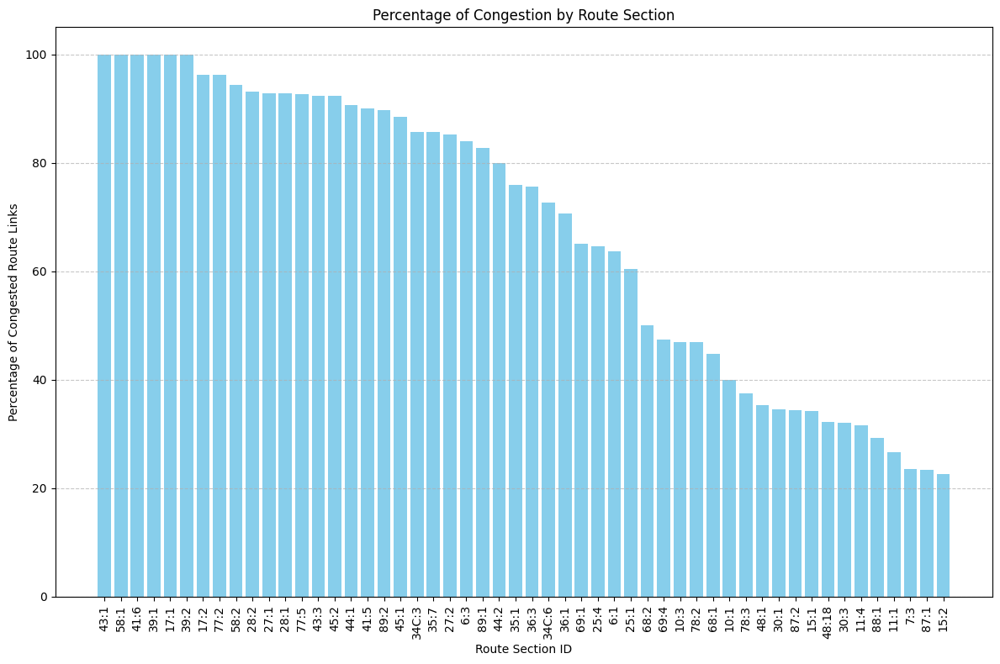

In [26]:
# Bar chart for percentage of congestion by route section

data_to_plot = congestion_summary_df[congestion_summary_df['PercentageCongested'] > 20].sort_values(by = 'PercentageCongested', ascending = False)
plt.figure(figsize=(12, 8))
plt.bar(data_to_plot['RouteSectionId'].astype(str), data_to_plot['PercentageCongested'], color='skyblue')
plt.xlabel('Route Section ID')
plt.ylabel('Percentage of Congested Route Links')
plt.title('Percentage of Congestion by Route Section')
plt.xticks(rotation=90)  # Rotate x-axis labels if they are long
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


In [27]:
congestion_summary_df[congestion_summary_df['PercentageCongested'] > 50].sort_values(by = 'PercentageCongested', ascending = False).describe(include = 'all')

,RouteSectionId,TotalLinks,CongestedLinks,PercentageCongested
count,33,33.000000,33.000000,33.000000
unique,33,NaN,NaN,NaN
top,17:1,NaN,NaN,NaN
freq,1,NaN,NaN,NaN
mean,NaN,29.787879,25.121212,86.457658
std,NaN,11.491186,8.528473,11.857865
min,NaN,10.000000,9.000000,60.416667
25%,NaN,25.000000,22.000000,80.000000
50%,NaN,28.000000,25.000000,90.000000
75%,NaN,34.000000,29.000000,94.285714


In [29]:
# Map a Single Route
routeSectionId = '30:3'

# Load the route links
routeLinks_df = pd.read_hdf('/content/drive/MyDrive/MSc Project Data/timetable_dataframes/routeLinks_df_processed.h5', key = 'df')

routeLink_df = routeLinks_df[routeLinks_df['RouteSectionId'] == routeSectionId]

# Extract all coordinates to calculate the map's center
all_coords = [(coord[0], coord[1]) for track in routeLink_df['Track(Longitude, Latitude)'] for coord in track]

# Calculate the map center
center_lat = sum(lat for lon, lat in all_coords) / len(all_coords)
center_lon = sum(lon for lon, lat in all_coords) / len(all_coords)

# Initialize the Folium map
mymap = folium.Map(location=[center_lat, center_lon], zoom_start=12)

# Define a list of colors
cluster_colors = [None, None, None]
cluster_colors[low_congestion_cluster] = 'blue'
cluster_colors[medium_congestion_cluster] = 'yellow'
cluster_colors[high_congestion_cluster] = 'red'

# Add routes to the map with different colors for each Cluster
route_colors = {}
for idx, row in routeLink_df.iterrows():
    route_section_id = row['RouteSectionId']

    track_coords = row['Track(Longitude, Latitude)']
    route_link_id = row['RouteLinkId']
    cluster = avg_speed_df.loc[avg_speed_df['RouteLinkId'] == route_link_id, 'KNN Cluster(k = 3)']

    if not cluster.empty:
      route_colors[route_section_id] = cluster_colors[cluster.values[0]] ##################
    else:
      continue

    # Draw the route link
    folium.PolyLine(
        locations=[(lat, lon) for lon, lat in track_coords],
        color=route_colors[route_section_id],
        weight=5,
        opacity=0.8,
        popup=f"RouteSectionId: {route_section_id}, RouteLinkId: {row['RouteLinkId']}"
    ).add_to(mymap)

# Display the map
mymap

## Congestion Heat Map

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` ex

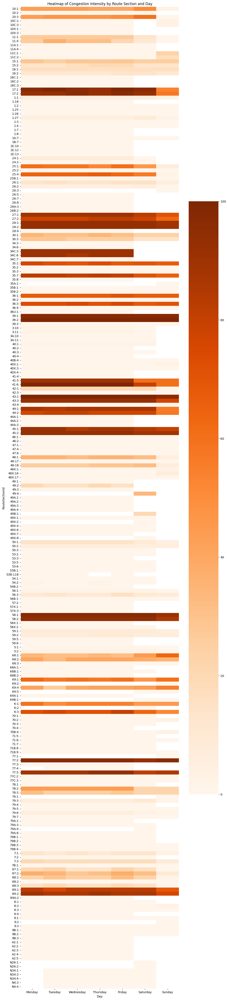

In [30]:
# Heatmap to show congestion intensity by route section and day

days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
start_time = None
end_time = None
no_constraints = False
only_day = True

heatmap_data_list = []

# Loop through the week days
for day in days:
  speed_df = calculate_avg_speed(day, start_time, end_time, no_constraints, only_day)
  speed_df = remove_outliers(speed_df)
  # Features to use for k-means
  features = speed_df[['AverageSpeed', 'BusDensity']]
  # Normalize the features
  scaler = StandardScaler()
  features_scaled = scaler.fit_transform(features)
  k = 3  # Number of clusters
  kmeans = KMeans(n_clusters=k, random_state=42)
  speed_df['KNN Cluster(k = ' + str(k) + ')'] = kmeans.fit_predict(features_scaled)

  centers = kmeans.cluster_centers_

  # Get the cluster numbers according to congestion
  low_congestion_cluster = np.argmax(centers[:, 0])
  high_congestion_cluster = np.argmax(centers[:, 1])
  # Determine medium congestion cluster (remaining cluster)
  all_clusters = {0, 1, 2}
  medium_congestion_cluster = list(all_clusters - {low_congestion_cluster, high_congestion_cluster})[0]

  congestion_df = get_congestion_summary(speed_df, high_congestion_cluster)

  congestion_df['Day'] = day

  heatmap_data_list.append(congestion_df)

# Concatenate all DataFrames in the list into a single DataFrame
heatmap_data = pd.concat(heatmap_data_list, ignore_index=True)
pivot_table = heatmap_data.pivot(index = 'RouteSectionId', columns = 'Day', values = 'PercentageCongested')
pivot_table = pivot_table[days]  # Reorder columns according to the specified order

plt.figure(figsize=(12,60))

sns.heatmap(pivot_table, annot=False, cmap='Oranges', fmt=".1f")

plt.title('Heatmap of Congestion Intensity by Route Section and Day')
plt.show()

In [31]:
# Calculate the average speed and bus density based on day and time

def calculate_avg_speeds(day, start_time, end_time, no_constraints, only_day, groups = ['RouteLinkId', 'Day']):
  # Extract data after applying the constraints
  if groups == ['RouteLinkId', 'TimeInterval']:
    if no_constraints:
      avg_speed_df = arrivalTimes_intervals_df.copy()
    elif only_day:
      avg_speed_df = arrivalTimes_intervals_df[arrivalTimes_df['Day'] == day].copy()
    else:
      avg_speed_df = arrivalTimes_intervals_df[
          (arrivalTimes_intervals_df['Day'] == day) &
          (arrivalTimes_intervals_df['ActualDepartureTime'].apply(lambda x: x.time()) >= start_time) &
          (arrivalTimes_intervals_df['ActualDepartureTime'].apply(lambda x: x.time()) <= end_time) &
          (arrivalTimes_intervals_df['ActualArrivalTime'].apply(lambda x: x.time()) >= start_time) &
          (arrivalTimes_intervals_df['ActualArrivalTime'].apply(lambda x: x.time()) <= end_time)
      ].copy()
  else:
    if no_constraints:
      avg_speed_df = arrivalTimes_df.copy()
    elif only_day:
      avg_speed_df = arrivalTimes_df[arrivalTimes_df['Day'] == day].copy()
    else:
      avg_speed_df = arrivalTimes_df[
          (arrivalTimes_df['Day'] == day) &
          (arrivalTimes_df['ActualDepartureTime'].apply(lambda x: x.time()) >= start_time) &
          (arrivalTimes_df['ActualDepartureTime'].apply(lambda x: x.time()) <= end_time) &
          (arrivalTimes_df['ActualArrivalTime'].apply(lambda x: x.time()) >= start_time) &
          (arrivalTimes_df['ActualArrivalTime'].apply(lambda x: x.time()) <= end_time)
      ].copy()

  # Drop na
  avg_speed_df = avg_speed_df.dropna()

  # Create BusCount column by counting the number of rows in each RouteLinkId group
  avg_speed_df['BusCount'] = avg_speed_df.groupby(groups)['RouteLinkId'].transform('count')

  # Calculate the average distance, speed and bus count for each route link
  avg_speed_df = avg_speed_df.groupby(groups).agg({
      'TrackDistance': 'mean',
      'Speed': 'mean',
      'BusCount': 'mean'
  }).reset_index()

  # Calculate the bus density using the formula (bus count / track distance)
  avg_speed_df['BusDensity'] = avg_speed_df.apply(lambda row: row['BusCount'] / row['TrackDistance'], axis=1)

  # Rename the speed column as average speed
  avg_speed_df.rename(columns={'Speed': 'AverageSpeed'}, inplace=True)
  return avg_speed_df

# Calculate percentage of congestion on each route section

def get_congestion_summaries(avg_speed_df, congested_cluster, groups = ['RouteSectionId', 'Day']):

  routeLinks_df = pd.read_hdf('/content/drive/MyDrive/MSc Project Data/timetable_dataframes/routeLinks_df_processed.h5', key = 'df')

  # Get the route section id based on the route link id
  route_congestion_df = pd.merge(routeLinks_df[['RouteSectionId', 'RouteLinkId']], avg_speed_df, how = 'right', on = 'RouteLinkId')

  # Calculate the total number of route links per RouteSectionId
  total_links_per_section = route_congestion_df.groupby(groups).size()

  # Calculate the number of congested route links per RouteSectionId
  congested_links_per_section = route_congestion_df[route_congestion_df['KNN Cluster(k = 3)'] == congested_cluster].groupby(groups).size()

  # Merge the two Series to align them by RouteSectionId
  congestion_summary_df = pd.DataFrame({
      'TotalLinks': total_links_per_section,
      'CongestedLinks': congested_links_per_section.reindex(total_links_per_section.index, fill_value=0)
  })

  # Calculate the percentage of congested route links
  congestion_summary_df['PercentageCongested'] = (congestion_summary_df['CongestedLinks'] / congestion_summary_df['TotalLinks']) * 100

  # Reset index for a clean DataFrame output
  congestion_summary_df = congestion_summary_df.reset_index()
  return congestion_summary_df


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


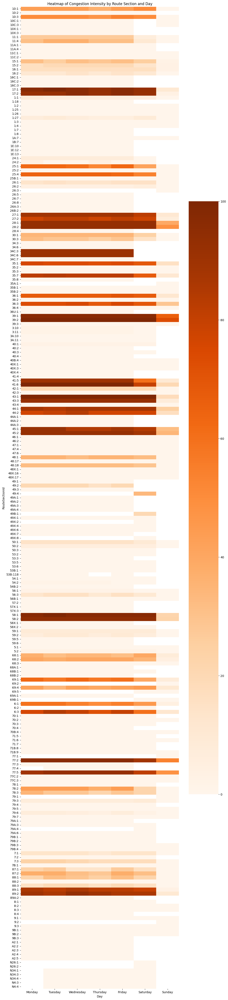

In [32]:
# Heatmap to show congestion intensity by route section and day

days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
start_time = None
end_time = None
no_constraints = True
only_day = True

heatmap_data_list = []


speed_df = calculate_avg_speeds(day, start_time, end_time, no_constraints, only_day)
speed_df = remove_outliers(speed_df)
# Features to use for k-means
features = speed_df[['AverageSpeed', 'BusDensity']]
# Normalize the features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)
k = 3  # Number of clusters
kmeans = KMeans(n_clusters=k, random_state=42)
speed_df['KNN Cluster(k = ' + str(k) + ')'] = kmeans.fit_predict(features_scaled)

centers = kmeans.cluster_centers_

# Get the cluster numbers according to congestion
low_congestion_cluster = np.argmax(centers[:, 0])
high_congestion_cluster = np.argmax(centers[:, 1])
# Determine medium congestion cluster (remaining cluster)
all_clusters = {0, 1, 2}
medium_congestion_cluster = list(all_clusters - {low_congestion_cluster, high_congestion_cluster})[0]


congestion_df = get_congestion_summaries(speed_df, high_congestion_cluster)

heatmap_data_list.append(congestion_df)

# Concatenate all DataFrames in the list into a single DataFrame
heatmap_data = pd.concat(heatmap_data_list, ignore_index=True)
pivot_table = heatmap_data.pivot(index = 'RouteSectionId', columns = 'Day', values = 'PercentageCongested')
pivot_table = pivot_table[days]  # Reorder columns according to the specified order

plt.figure(figsize=(12,60))

sns.heatmap(pivot_table, annot=False, cmap='Oranges', fmt=".1f")

plt.title('Heatmap of Congestion Intensity by Route Section and Day')
plt.show()

In [33]:
# Heatmap to show congestion intensity by route section and time interval

# Define time intervals
time_intervals = ['00:00-02:00', '02:00-04:00',
                  '04:00-06:00', '06:00-08:00',
                  '08:00-10:00', '10:00-12:00',
                  '12:00-14:00', '14:00-16:00',
                  '16:00-18:00', '18:00-20:00',
                  '20:00-22:00', '22:00-00:00']

# Function to assign time interval to each row of the data
def find_interval(row):
  departure_time = pd.to_datetime(row['ActualDepartureTime']).time()
  arrival_time = pd.to_datetime(row['ActualArrivalTime']).time()
  for time_interval in time_intervals:
    start, end = time_interval.split('-')
    start = pd.to_datetime(start).time()
    end = pd.to_datetime(end).time()
    if (departure_time >= start) and (departure_time <= end) and (arrival_time >= start) and (arrival_time <= end):
        return time_interval
  return None


In [ ]:
# Assign time intervals to the arrival Times data
arrivalTimes_intervals_df = arrivalTimes_df.copy()
arrivalTimes_intervals_df['TimeInterval'] = arrivalTimes_intervals_df.apply(find_interval, axis = 1)

# Save the data with intervals
arrivalTimes_intervals_df.to_hdf('/content/drive/MyDrive/MSc Project Data/arrival_times_intervals.h5', key='df', mode='w')

arrivalTimes_intervals_df

In [34]:
# Load the arrival time intervals
arrivalTimes_intervals_df = pd.read_hdf('/content/drive/MyDrive/MSc Project Data/arrival_times_intervals.h5', key = 'df')


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


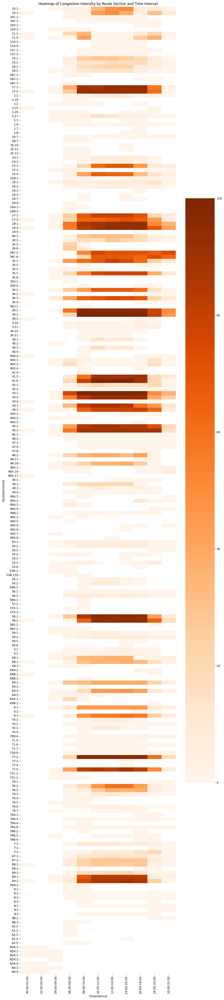

In [35]:
# Set constraints
start_time = None
end_time = None
no_constraints = True
only_day = True

heatmap_data_list = []

speed_df = calculate_avg_speeds(day, start_time, end_time, no_constraints, only_day, ['RouteLinkId', 'TimeInterval'])
speed_df = remove_outliers(speed_df)
# Features to use for k-means
features = speed_df[['AverageSpeed', 'BusDensity']]
# Normalize the features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)
k = 3  # Number of clusters
kmeans = KMeans(n_clusters=k, random_state=42)
speed_df['KNN Cluster(k = ' + str(k) + ')'] = kmeans.fit_predict(features_scaled)

centers = kmeans.cluster_centers_

# Get the cluster numbers according to congestion
low_congestion_cluster = np.argmax(centers[:, 0])
high_congestion_cluster = np.argmax(centers[:, 1])
# Determine medium congestion cluster (remaining cluster)
all_clusters = {0, 1, 2}
medium_congestion_cluster = list(all_clusters - {low_congestion_cluster, high_congestion_cluster})[0]

congestion_df = get_congestion_summaries(speed_df, high_congestion_cluster, ['RouteSectionId', 'TimeInterval'])

heatmap_data_list.append(congestion_df)

# Concatenate all DataFrames in the list into a single DataFrame
heatmap_data = pd.concat(heatmap_data_list, ignore_index=True)
pivot_table = heatmap_data.pivot(index = 'RouteSectionId', columns = 'TimeInterval', values = 'PercentageCongested')
# Filter only the columns that exist in both pivot_table and time_intervals
existing_intervals = [interval for interval in time_intervals if interval in pivot_table.columns]
pivot_table = pivot_table[existing_intervals]  # Reorder columns according to the specified order

plt.figure(figsize=(12,60))

sns.heatmap(pivot_table, annot=False, cmap='Oranges', fmt=".1f")

plt.title('Heatmap of Congestion Intensity by Route Section and Time Interval')
plt.show()

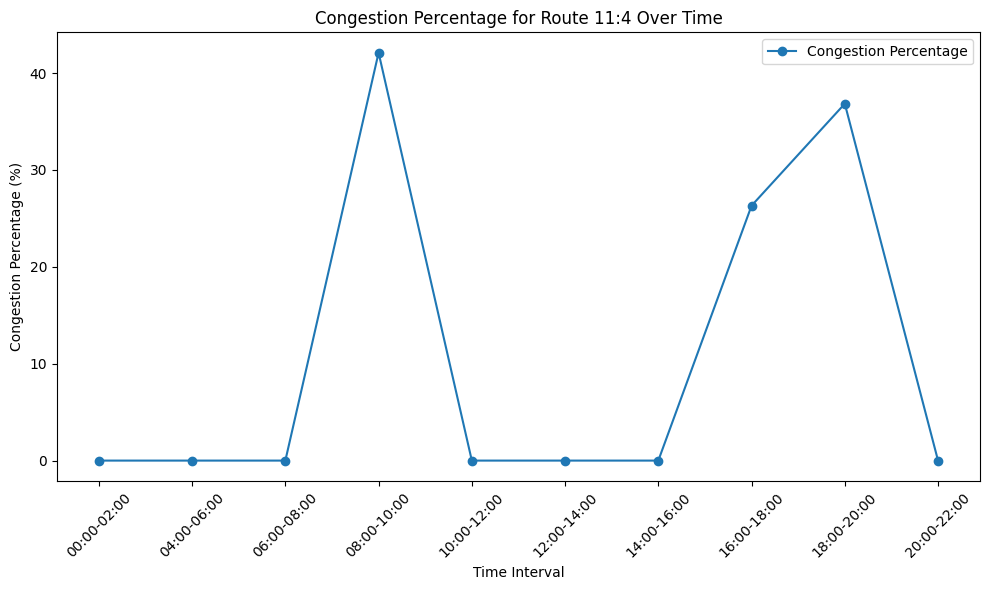

In [36]:
# Define the route section
specific_route = '11:4'

# Filter the DataFrame for the specific route
route_data = heatmap_data[(heatmap_data['RouteSectionId'] == specific_route)]

# Convert time intervals to a sorted order for plotting
route_data = route_data.sort_values(by='TimeInterval')

# Plotting the line graph
plt.figure(figsize=(10, 6))

plt.plot(route_data['TimeInterval'], route_data['PercentageCongested'], label='Congestion Percentage', marker='o')

plt.xlabel('Time Interval')
plt.ylabel('Congestion Percentage (%)')
plt.title(f'Congestion Percentage for Route {specific_route} Over Time')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

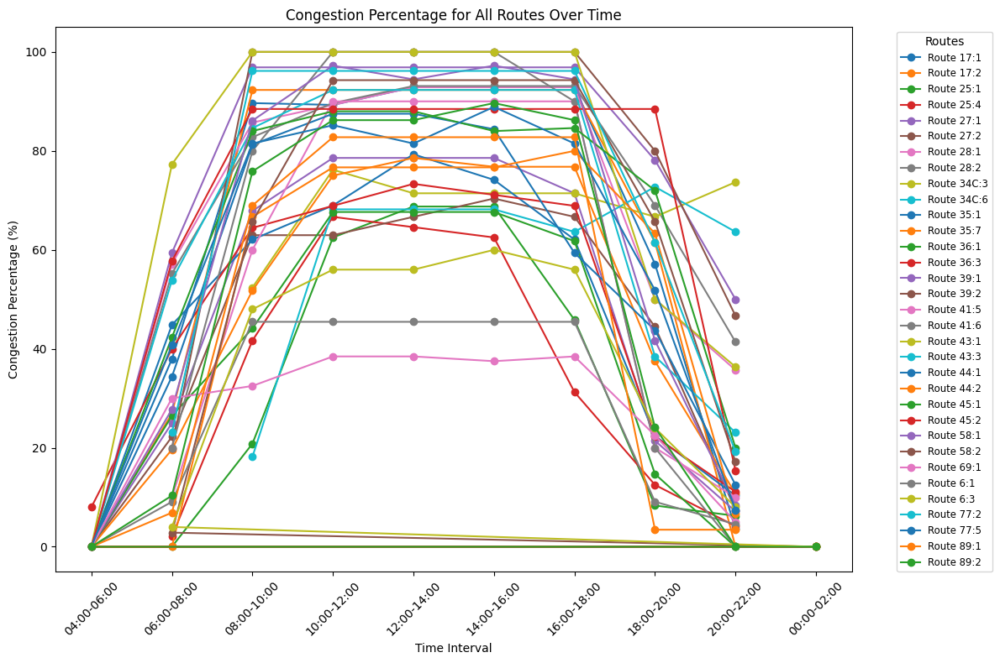

In [37]:
# Get all unique route section IDs with overall congestion above 50
all_routes = congestion_summary_df[congestion_summary_df['PercentageCongested'] > 50]['RouteSectionId'].unique()

# Sort time intervals (assuming 'TimeInterval' is sortable)
sorted_intervals = sorted(heatmap_data['TimeInterval'].unique())

# Initialize the plot
plt.figure(figsize=(12, 8))

# Loop through each route and plot its congestion percentage over time
for route in all_routes:
    # Filter data for the current route
    route_data = heatmap_data[heatmap_data['RouteSectionId'] == route]

    # Sort data by TimeInterval
    route_data = route_data.sort_values(by='TimeInterval')

    # Plot line graph for the current route
    plt.plot(route_data['TimeInterval'], route_data['PercentageCongested'], label=f'Route {route}', marker='o')

# Configure plot settings
plt.xlabel('Time Interval')
plt.ylabel('Congestion Percentage (%)')
plt.title('Congestion Percentage for All Routes Over Time')
plt.xticks(rotation=45)
plt.legend(title='Routes', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')
plt.tight_layout()
plt.show()

## Proposing Alternatives

In [38]:

# Load route links and route sections data
routeLinks_df = pd.read_hdf('/content/drive/MyDrive/MSc Project Data/timetable_dataframes/routeLinks_df_processed.h5', key='df')
arrivalTimes_df = pd.read_hdf('/content/drive/MyDrive/MSc Project Data/arrival_times_processed.h5', key = 'df')

runTimes_df = arrivalTimes_df.groupby('RouteLinkId').agg({
    'RunTime': 'mean'
}).reset_index()

routeLinks_merged_df = pd.merge(routeLinks_df, runTimes_df, how = 'left', on = 'RouteLinkId')

routeLinks_merged_df = routeLinks_merged_df.dropna()

# Create a graph from route links
G = nx.DiGraph()

# Add edges to the graph
for _, row in routeLinks_merged_df.iterrows():
    # Add edges with weight as distance or time
    G.add_edge(row['FromStopPointRef'], row['ToStopPointRef'], weight=row['RunTime'])

def get_alternative_route(route_section_id):

  try:
    route_section_df = routeLinks_merged_df[routeLinks_merged_df['RouteSectionId'] == route_section_id]
    # Extract the integer value after the first underscore
    route_section_df['SequenceNumber'] = route_section_df['RouteLinkId'].apply(lambda x: int(x.split('_')[1]))

    start_stop = route_section_df.loc[route_section_df['SequenceNumber'].idxmin()]['FromStopPointRef']
    end_stop = route_section_df.loc[route_section_df['SequenceNumber'].idxmax()]['ToStopPointRef']

    # Find alternative routes
    alternative_route = nx.shortest_path(G, source=start_stop, target=end_stop, weight='weight')
  except:
    return None

  return alternative_route

# Function to get the path of the main route
def get_main_route(route_section_id):
  main_route_links = routeLinks_df[routeLinks_df['RouteSectionId'] == route_section_id]
  main_route = main_route_links['FromStopPointRef'].tolist() + [main_route_links['ToStopPointRef'].tolist()[-1]]
  return main_route

# Get the run time of the main route
def get_main_route_run_time(route_section_id):
  main_route_run_time = routeLinks_merged_df[routeLinks_merged_df['RouteSectionId'] == route_section_id]['RunTime'].sum()
  return main_route_run_time

# Get the path and run time of the alternative route
def get_alternative_coords_and_run_time(alternative_route):
  if alternative_route:
    alternative_coords = ()
    alternative_run_time = 0
    for i in range (len(alternative_route)-1):
      from_point = alternative_route[i]
      to_point = alternative_route[i+1]
      coords = routeLinks_df[(routeLinks_df['FromStopPointRef'] == from_point) & (routeLinks_df['ToStopPointRef'] == to_point)].iloc[0]['Track(Longitude, Latitude)']
      alternative_run_time += routeLinks_merged_df[(routeLinks_merged_df['FromStopPointRef'] == from_point) & (routeLinks_merged_df['ToStopPointRef'] == to_point)].iloc[0]['RunTime']
      alternative_coords += coords
  else:
    return None, None
  return alternative_coords, alternative_run_time



In [39]:
# Example usage
route_section_id = '36:1'

# Get main route as a sequence of route links
main_route = get_main_route(route_section_id)
main_route_run_time = get_main_route_run_time(route_section_id)

# Get alternative route
alternative_route = get_alternative_route(route_section_id)
alternative_coords, alternative_run_time = get_alternative_coords_and_run_time(alternative_route)


# Print routes
print("Main Route:", round(main_route_run_time/60, 4), 'minutes')
print(main_route)
print()

if alternative_route == main_route:
  print('Main route itself is the fastest route')
else:
  print('Alternative route:', round(alternative_run_time/60, 4), 'minutes')
  print(alternative_route)
  print()


<ipython-input-38-da9a9256afb8>:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  route_section_df['SequenceNumber'] = route_section_df['RouteLinkId'].apply(lambda x: int(x.split('_')[1]))


Main Route: 37.2633 minutes
['3390J4', '3390E2', '3390A4', '3390Y4', '3390CC04', '3390LE07', '3390LE08', '3390LE09', '3390LE10', '3390LE11', '3390LE12', '3390QM04', '3390UN15', '3390UN16', '3390UN17', '3390UN18', '3390UN19', '3390UN20', '3390UN21', '3390UN22', '3390UN23', '3300BR0524', '3300BR0523', '3300BR0241', '3300BR0213', '3300BR0613', '3300BR0095', '3300BR0097', '3300BR0080', '3300BR0075', '3300BR0503', '3300BR0026', '3300BR0028', '3300BR0626', '3300BR0197']

Alternative route: 20.408 minutes
['3390J4', '3390E2', '3390A3', '3390Y4', '3390CC04', '3390LE07', '3390LE08', '3390LE09', '3390LE10', '3390LE11', '3390LE12', '3390QM04', '3390UN43', '3390UN46', '3390UN44', '3390UN45', '3390UN33', '3300BR0524', '3300BR0523', '3300BR0241', '3300BR0213', '3300BR0613', '3300BR0095', '3300BR0097', '3300BR0080', '3300BR0075', '3300BR0503', '3300BR0026', '3300BR0028', '3300BR0626', '3300BR0197']



In [40]:
# Map the original and alternative route

# Map a Single Route
routeSectionId = route_section_id

# Load the route links
routeLinks_df = pd.read_hdf('/content/drive/MyDrive/MSc Project Data/timetable_dataframes/routeLinks_df_processed.h5', key = 'df')

routeLink_df = routeLinks_df[routeLinks_df['RouteSectionId'] == routeSectionId]

# Extract all coordinates to calculate the map's center
all_coords = [(coord[0], coord[1]) for track in routeLink_df['Track(Longitude, Latitude)'] for coord in track]

# Calculate the map center
center_lat = sum(lat for lon, lat in all_coords) / len(all_coords)
center_lon = sum(lon for lon, lat in all_coords) / len(all_coords)

# Initialize the Folium map
mymap = folium.Map(location=[center_lat, center_lon], zoom_start=12)

# Define a list of colors
cluster_colors = [None, None, None]
cluster_colors[low_congestion_cluster] = 'blue'
cluster_colors[medium_congestion_cluster] = 'yellow'
cluster_colors[high_congestion_cluster] = 'red'

# Add routes to the map with different colors for each Cluster
route_colors = {}
for idx, row in routeLink_df.iterrows():
    route_section_id = row['RouteSectionId']

    track_coords = row['Track(Longitude, Latitude)']
    route_link_id = row['RouteLinkId']
    cluster = avg_speed_df.loc[avg_speed_df['RouteLinkId'] == route_link_id, 'KNN Cluster(k = 3)']

    if not cluster.empty:
      route_colors[route_section_id] = cluster_colors[cluster.values[0]] ##################
    else:
      continue

    # Draw the route link
    folium.PolyLine(
        locations=[(lat, lon) for lon, lat in track_coords],
        color=route_colors[route_section_id],
        weight=5,
        opacity=0.8,
        popup=f"RouteSectionId: {route_section_id}, RouteLinkId: {row['RouteLinkId']}"
    ).add_to(mymap)

# Draw the alternate route
folium.PolyLine(
    locations=[(lat, lon) for lon, lat in alternative_coords],
    color='green',
    weight=5,
    opacity=0.6,
    popup=f"RouteSectionId: {routeSectionId}, RouteLinkId: "
).add_to(mymap)

# Display the map
mymap

## Evaluation

In [41]:
# Filter the routes with congestion percentage greater than 70
routes_df = congestion_summary_df[congestion_summary_df['PercentageCongested'] > 70].sort_values(by = 'PercentageCongested', ascending = False)[['RouteSectionId', 'PercentageCongested']]
routes_df = routes_df.drop_duplicates()
# Reset index to ensure clean indexing
routes_df = routes_df.reset_index(drop=True)

# Get the main and alternative routes along with run times for all those routes with congestion percentage more than 70
routes_df['MainRoute'] = routes_df['RouteSectionId'].apply(lambda x: get_main_route(x))
routes_df['MainRouteRunTime'] = routes_df['RouteSectionId'].apply(lambda x: get_main_route_run_time(x))
routes_df['AlternativeRoute'] = routes_df['RouteSectionId'].apply(lambda x: get_alternative_route(x))
routes_df['AlternativeRouteRunTime'] = routes_df['AlternativeRoute'].apply(lambda x: get_alternative_coords_and_run_time(x)[1])
routes_df

<ipython-input-38-da9a9256afb8>:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  route_section_df['SequenceNumber'] = route_section_df['RouteLinkId'].apply(lambda x: int(x.split('_')[1]))
<ipython-input-38-da9a9256afb8>:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  route_section_df['SequenceNumber'] = route_section_df['RouteLinkId'].apply(lambda x: int(x.split('_')[1]))
<ipython-input-38-da9a9256afb8>:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try us

,RouteSectionId,PercentageCongested,MainRoute,MainRouteRunTime,AlternativeRoute,AlternativeRouteRunTime
0,17:1,100.000000,"[3390BU01, 3390BUT1, 3390BU21, 3390BU61, 3390B...",1776.243981,"[3390BU01, 3390BUT1, 3390BU21, 3390BU61, 3390B...",1762.311392
1,43:1,100.000000,"[3390BF07, 3390BF08, 3390BF21, 3390BF09, 3300G...",1450.268128,"[3390BF07, 3390BF08, 3390BF21, 3390BF09, 3300G...",1458.610880
2,58:1,100.000000,"[3300GE0363, 3300GE0369, 3300GE0370, 3300GE037...",1962.985138,"[3300GE0363, 3300GE0369, 3300GE0370, 3300GE037...",1664.466640
3,39:1,100.000000,"[3300GE0802, 3300GE0123, 3300GE0124, 3300GE012...",1898.917596,"[3300GE0802, 3300GE0123, 3300GE0124, 3300GE012...",1898.917596
4,39:2,100.000000,"[3390Q3, 3390V2, 3390H4, 3390GR30, 3390GR31, 3...",876.035200,"[3390Q3, 3390V2, 3390H4, 3390GR30, 3390GR31, 3...",876.035200
5,41:6,100.000000,"[3390Q2, 3390V2, 3390H4, 3390SA09, 3390SA10, 3...",729.719968,"[3390Q2, 3390V2, 3390H4, 3390SA09, 3390SA10, 3...",676.389717
6,77:2,96.153846,"[3390ST11, 3390ST12, 3390ST13, 3390ST06, 3390S...",1571.181333,"[3390ST11, 3390ST12, 3390ST13, 3390ST06, 3390S...",1186.462662
7,17:2,96.153846,"[3390T3, 3390FO11, 3390FO12, 3390FO15, 3390FO3...",1566.875684,"[3390T3, 3390FO11, 3390FO12, 3390FO15, 3390FO3...",1566.382802
8,58:2,94.285714,"[3390P2, 3390T6, 3390FO01, 3390FO02, 3390FO15,...",2001.073968,"[3390P2, 3390T6, 3390FO01, 3390FO02, 3390FO15,...",1572.731297
9,28:2,93.103448,"[3390J6, 3390U2, 3390Y3, 3390CC06, 3390RA01, 3...",1834.340567,"[3390J6, 3390U2, 3390Y3, 3390CC06, 3390RA01, 3...",1822.646408


In [42]:
routes_df.describe(include = 'all')

,RouteSectionId,PercentageCongested,MainRoute,MainRouteRunTime,AlternativeRoute,AlternativeRouteRunTime
count,29,29.000000,29,29.000000,29,29.000000
unique,29,NaN,29,NaN,29,NaN
top,17:1,NaN,"[3390BU01, 3390BUT1, 3390BU21, 3390BU61, 3390B...",NaN,"[3390BU01, 3390BUT1, 3390BU21, 3390BU61, 3390B...",NaN
freq,1,NaN,1,NaN,1,NaN
mean,NaN,89.636770,NaN,1671.574470,NaN,1456.057206
std,NaN,8.595117,NaN,680.583978,NaN,487.699559
min,NaN,70.588235,NaN,254.072741,NaN,336.565357
25%,NaN,85.185185,NaN,1450.268128,NaN,1224.482647
50%,NaN,92.307692,NaN,1701.337813,NaN,1566.382802
75%,NaN,96.153846,NaN,1962.985138,NaN,1762.311392


In [43]:
# Percentage decrease in run time
mean_main_run_time = routes_df['MainRouteRunTime'].mean()
mean_alternative_run_time = routes_df['AlternativeRouteRunTime'].mean()
print('Mean Run Time for Main Route: ', mean_main_run_time)
print('Mean Run Time for Alternative Route:', mean_alternative_run_time)
print('Perentage decrease in runtime:', (mean_main_run_time - mean_alternative_run_time)/mean_main_run_time)
print()

# Paired t-test
t_stat, p_value = stats.ttest_rel(routes_df['MainRouteRunTime'], routes_df['AlternativeRouteRunTime'])
print(f'Paired T-statistic: {t_stat}, P-value: {p_value}')


Mean Run Time for Main Route:  1671.574470017978
Mean Run Time for Alternative Route: 1456.0572064153278
Perentage decrease in runtime: 0.128930698253804

Paired T-statistic: 3.462612383045755, P-value: 0.0017371964721237762
